# A) Reading & Extracting the file


In [20]:
# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

# Common imports
import numpy as np
import os

from sklearn.model_selection import cross_validate
from sklearn import tree
from sklearn import preprocessing
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA


# Where to save the figures
PROJECT_ROOT_DIR = "."
CHAPTER_ID = "ann"
IMAGES_PATH = os.path.join(PROJECT_ROOT_DIR, "images", CHAPTER_ID)
os.makedirs(IMAGES_PATH, exist_ok=True)

def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGES_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)
    
import pandas as pd

# to make this notebook's output stable across runs
np.random.seed(42)

# Ignore useless warnings (see SciPy issue #5998)
import warnings
warnings.filterwarnings(action="ignore", message="^internal gelsd")

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# open the csv file
data = pd.read_csv('Wellbeing_and_lifestyle_data_Kaggle.csv')
print(data.shape)
# preview the dataset
data.head()

(15971, 25)


,Timestamp,FRUITS_VEGGIES,DAILY_STRESS,PLACES_VISITED,CORE_CIRCLE,SUPPORTING_OTHERS,SOCIAL_NETWORK,ACHIEVEMENT,DONATION,BMI_RANGE,...,LOST_VACATION,DAILY_SHOUTING,SUFFICIENT_INCOME,PERSONAL_AWARDS,TIME_FOR_PASSION,WEEKLY_MEDITATION,AGE,GENDER,WORK_LIFE_BALANCE_SCORE,Score
0,7/7/2015,3,2,2,5,0,5,2,0,1,...,5,5,1,4,0,5,36 to 50,Female,609.5,Good
1,7/7/2015,2,3,4,3,8,10,5,2,2,...,2,2,2,3,2,6,36 to 50,Female,655.6,Good
2,7/7/2015,2,3,3,4,4,10,3,2,2,...,10,2,2,4,8,3,36 to 50,Female,631.6,Good
3,7/7/2015,3,3,10,3,10,7,2,5,2,...,7,5,1,5,2,0,51 or more,Female,622.7,Good
4,7/7/2015,5,1,3,3,10,4,2,4,2,...,0,0,2,8,1,5,51 or more,Female,663.9,Good


We have 15972 instances and 25 attributes in the dataset 

# B) Exploratory Data Analysis & Data Cleaning 

## B.1 Missing Vlaues 

In [21]:
#This method prints information about a DataFrame including the dtype and columns, non-null values and memory usage.
# view summary of dataset
print(data.info())

# Another way to check the missing values 
print(data.isnull().sum())

print(data.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15971 entries, 0 to 15970
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Timestamp                15971 non-null  object 
 1   FRUITS_VEGGIES           15971 non-null  int64  
 2   DAILY_STRESS             15971 non-null  int64  
 3   PLACES_VISITED           15971 non-null  int64  
 4   CORE_CIRCLE              15971 non-null  int64  
 5   SUPPORTING_OTHERS        15971 non-null  int64  
 6   SOCIAL_NETWORK           15971 non-null  int64  
 7   ACHIEVEMENT              15971 non-null  int64  
 8   DONATION                 15971 non-null  int64  
 9   BMI_RANGE                15971 non-null  int64  
 10  TODO_COMPLETED           15971 non-null  int64  
 11  FLOW                     15971 non-null  int64  
 12  DAILY_STEPS              15971 non-null  int64  
 13  LIVE_VISION              15971 non-null  int64  
 14  SLEEP_HOURS           

Conclusion: 
We can see there are no missing values and we confirm this further. we have also 4 categorical variables: Timestamp, AGE, 
Gender and Score. Score is the target variable.

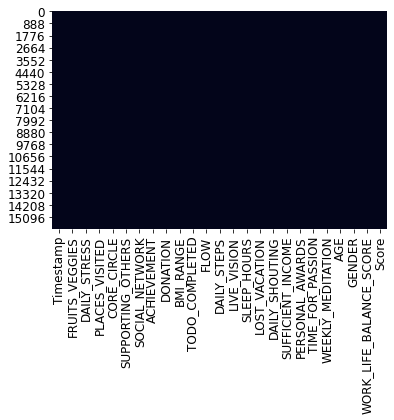

In [22]:
# Visualize missing values 
import seaborn as sns
ax = sns.heatmap(data.isnull(), cbar=False)

## B.2  Encoding Categorical Features

In [23]:
# our data is already clean so we don't have to clean the missing values 
# we will need to encode the cat features
data['AGE_encoded'] = data['AGE'].map( {'21 to 35':0, '36 to 50':1, '51 or more':2, 'Less than 20':3})
data[['AGE', 'AGE_encoded']]

data['GENDER_encoded'] = data['GENDER'].map( {'Male':1, 'Female':0})
data[['GENDER', 'GENDER_encoded']]

data['Score_encoded'] = data['Score'].map( {'Poor':0, 'Good':1, 'Excellent':2})
data[['Score', 'Score_encoded']]


data_encoded = data.drop(['AGE', 'GENDER', 'Score' ], axis=1)
data_original = data_encoded

# check again if our features are numerical 
data_encoded.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15971 entries, 0 to 15970
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Timestamp                15971 non-null  object 
 1   FRUITS_VEGGIES           15971 non-null  int64  
 2   DAILY_STRESS             15971 non-null  int64  
 3   PLACES_VISITED           15971 non-null  int64  
 4   CORE_CIRCLE              15971 non-null  int64  
 5   SUPPORTING_OTHERS        15971 non-null  int64  
 6   SOCIAL_NETWORK           15971 non-null  int64  
 7   ACHIEVEMENT              15971 non-null  int64  
 8   DONATION                 15971 non-null  int64  
 9   BMI_RANGE                15971 non-null  int64  
 10  TODO_COMPLETED           15971 non-null  int64  
 11  FLOW                     15971 non-null  int64  
 12  DAILY_STEPS              15971 non-null  int64  
 13  LIVE_VISION              15971 non-null  int64  
 14  SLEEP_HOURS           

## B.3  Visualize Outliers  

<AxesSubplot:xlabel='Score_encoded'>

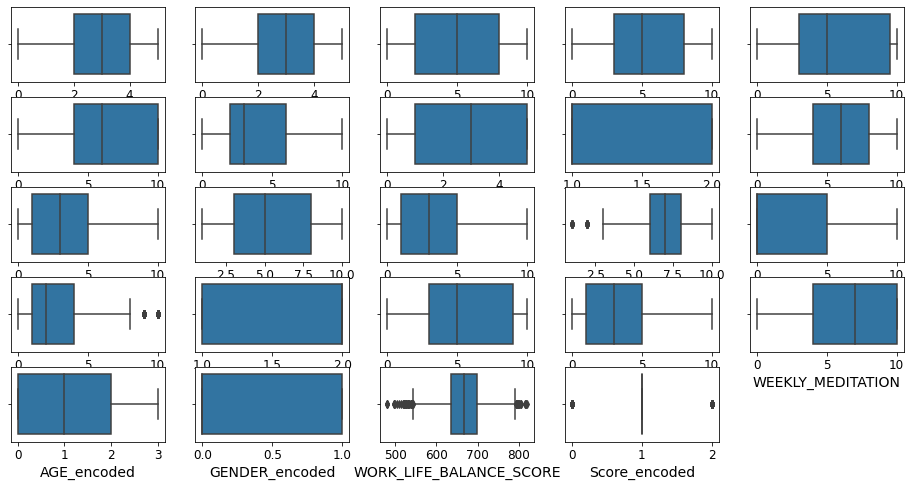

In [24]:
import seaborn as sns
plt.figure(figsize=(16,8))
plt.subplot(5,5,1)
sns.boxplot(x=data_encoded['FRUITS_VEGGIES'])
plt.subplot(5,5,2)
sns.boxplot(x=data_encoded['DAILY_STRESS'])
plt.subplot(5,5,3)
sns.boxplot(x=data_encoded['PLACES_VISITED'])
plt.subplot(5,5,4)
sns.boxplot(x=data_encoded['CORE_CIRCLE'])
plt.subplot(5,5,5)
sns.boxplot(x=data_encoded['SUPPORTING_OTHERS'])
plt.subplot(5,5,6)
sns.boxplot(x=data_encoded['SOCIAL_NETWORK'])
plt.subplot(5,5,7)
sns.boxplot(x=data_encoded['ACHIEVEMENT'])
plt.subplot(5,5,8)
sns.boxplot(x=data_encoded['DONATION'])
plt.subplot(5,5,9)
sns.boxplot(x=data_encoded['BMI_RANGE'])
plt.subplot(5,5,10)
sns.boxplot(x=data_encoded['TODO_COMPLETED'])
plt.subplot(5,5,11)
sns.boxplot(x=data_encoded['FLOW'])
plt.subplot(5,5,12)
sns.boxplot(x=data_encoded['DAILY_STEPS'])
plt.subplot(5,5,13)
sns.boxplot(x=data_encoded['LIVE_VISION'])
plt.subplot(5,5,14)
sns.boxplot(x=data_encoded['SLEEP_HOURS'])
plt.subplot(5,5,15)
sns.boxplot(x=data_encoded['LOST_VACATION'])
plt.subplot(5,5,16)
sns.boxplot(x=data_encoded['DAILY_SHOUTING'])
plt.subplot(5,5,17)
sns.boxplot(x=data_encoded['SUFFICIENT_INCOME'])
plt.subplot(5,5,18)
sns.boxplot(x=data_encoded['PERSONAL_AWARDS'])
plt.subplot(5,5,19)
sns.boxplot(x=data_encoded['TIME_FOR_PASSION'])
plt.subplot(5,5,20)
sns.boxplot(x=data_encoded['WEEKLY_MEDITATION'])
plt.subplot(5,5,21)
sns.boxplot(x=data_encoded['AGE_encoded'])
plt.subplot(5,5,22)
sns.boxplot(x=data_encoded['GENDER_encoded'])
plt.subplot(5,5,23)
sns.boxplot(x=data_encoded['WORK_LIFE_BALANCE_SCORE'])
plt.subplot(5,5,24)
sns.boxplot(x=data_encoded['Score_encoded'])

# C) Correlation Between the Target & all Attributes 

In [25]:
# Now we will look at the correlation of all the attributes with the expected class attribute (Score_encoded)
corr_matrix = data_encoded.corr()
corr_matrix["Score_encoded"].sort_values(ascending=False)

Score_encoded              1.000000
WORK_LIFE_BALANCE_SCORE    0.738394
ACHIEVEMENT                0.438569
SUPPORTING_OTHERS          0.421680
TIME_FOR_PASSION           0.409154
PERSONAL_AWARDS            0.387054
CORE_CIRCLE                0.383746
PLACES_VISITED             0.383527
FLOW                       0.371154
TODO_COMPLETED             0.370666
LIVE_VISION                0.364432
DONATION                   0.338972
FRUITS_VEGGIES             0.332362
DAILY_STEPS                0.316979
WEEKLY_MEDITATION          0.311099
SOCIAL_NETWORK             0.297269
SUFFICIENT_INCOME          0.252394
SLEEP_HOURS                0.135525
AGE_encoded                0.065964
GENDER_encoded            -0.020248
BMI_RANGE                 -0.180951
DAILY_SHOUTING            -0.190233
LOST_VACATION             -0.200386
DAILY_STRESS              -0.272068
Name: Score_encoded, dtype: float64

## C.1 Heat Map and correlation with target


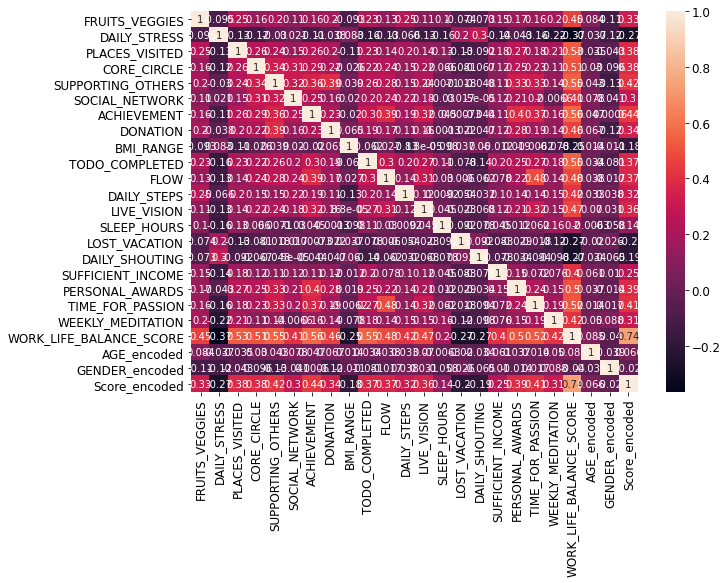

In [26]:
heatmap,ax = plt.subplots(figsize=(10,7))
sns.heatmap(data_encoded.corr(), annot=True, ax=ax)
plt.show()

## C.2  Zoom Correlation Scatterplot Between Target & Achievement

<AxesSubplot:xlabel='SUPPORTING_OTHERS', ylabel='Score_encoded'>

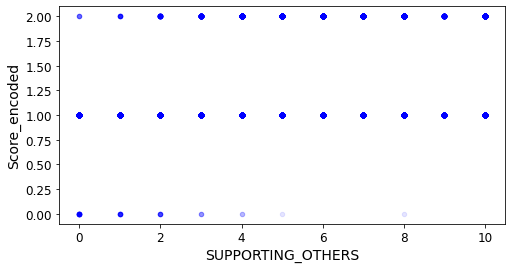

In [27]:
# let’s zoom in on the correlation scatterplot " Score_encoded & ACHIEVEMENT,"
data_encoded.plot(kind="scatter", x="SUPPORTING_OTHERS", y="Score_encoded", alpha=0.1 , c='blue', figsize=(8, 4))

## C.3  Drop  Fratures Less Correlated with the Target 

In [28]:
data_encoded = data_encoded.drop("SOCIAL_NETWORK", axis=1) 
data_encoded = data_encoded.drop("SUFFICIENT_INCOME", axis=1) 
data_encoded = data_encoded.drop("SLEEP_HOURS", axis=1) 
data_encoded = data_encoded.drop("AGE_encoded", axis=1) 
data_encoded = data_encoded.drop("GENDER_encoded", axis=1) 
data_encoded = data_encoded.drop("BMI_RANGE", axis=1) 
data_encoded = data_encoded.drop("DAILY_SHOUTING", axis=1) 
data_encoded = data_encoded.drop("LOST_VACATION", axis=1) 
data_encoded = data_encoded.drop("DAILY_STRESS", axis=1) 
data_encoded = data_encoded.drop("Timestamp", axis=1) 
data_encoded = data_encoded.drop("WORK_LIFE_BALANCE_SCORE", axis=1) 

In [29]:
data_original_cluster = data_original
data_encoded_cluster = data_encoded
data_original_cluster = data_original_cluster.drop("Timestamp", axis=1) 
data_original_cluster = data_original_cluster.drop("Score_encoded", axis=1) 
data_encoded_cluster = data_encoded_cluster.drop("Score_encoded", axis=1) 
data_original_cluster = data_original_cluster.drop("WORK_LIFE_BALANCE_SCORE", axis=1) 
print(data_encoded_cluster.info())
print(data_original_cluster.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15971 entries, 0 to 15970
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype
---  ------             --------------  -----
 0   FRUITS_VEGGIES     15971 non-null  int64
 1   PLACES_VISITED     15971 non-null  int64
 2   CORE_CIRCLE        15971 non-null  int64
 3   SUPPORTING_OTHERS  15971 non-null  int64
 4   ACHIEVEMENT        15971 non-null  int64
 5   DONATION           15971 non-null  int64
 6   TODO_COMPLETED     15971 non-null  int64
 7   FLOW               15971 non-null  int64
 8   DAILY_STEPS        15971 non-null  int64
 9   LIVE_VISION        15971 non-null  int64
 10  PERSONAL_AWARDS    15971 non-null  int64
 11  TIME_FOR_PASSION   15971 non-null  int64
 12  WEEKLY_MEDITATION  15971 non-null  int64
dtypes: int64(13)
memory usage: 1.6 MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15971 entries, 0 to 15970
Data columns (total 22 columns):
 #   Column             Non-Null Count  Dtype
--

In [18]:
data_encoded_cluster.head()

,FRUITS_VEGGIES,PLACES_VISITED,CORE_CIRCLE,SUPPORTING_OTHERS,ACHIEVEMENT,DONATION,TODO_COMPLETED,FLOW,DAILY_STEPS,LIVE_VISION,PERSONAL_AWARDS,TIME_FOR_PASSION,WEEKLY_MEDITATION
0,3,2,5,0,2,0,6,4,5,0,4,0,5
1,2,4,3,8,5,2,5,2,5,5,3,2,6
2,2,3,4,4,3,2,2,2,4,5,4,8,3
3,3,10,3,10,2,5,3,5,5,0,5,2,0
4,5,3,3,10,2,4,5,0,5,0,8,1,5


Drop the features that is less than 0.3 and take the rest as they are correlated with the target class.
We will remove the Timestamp column, as it represents the log time of surveys.

# D) Plot Histogram Graph for each Numerical Attribute 

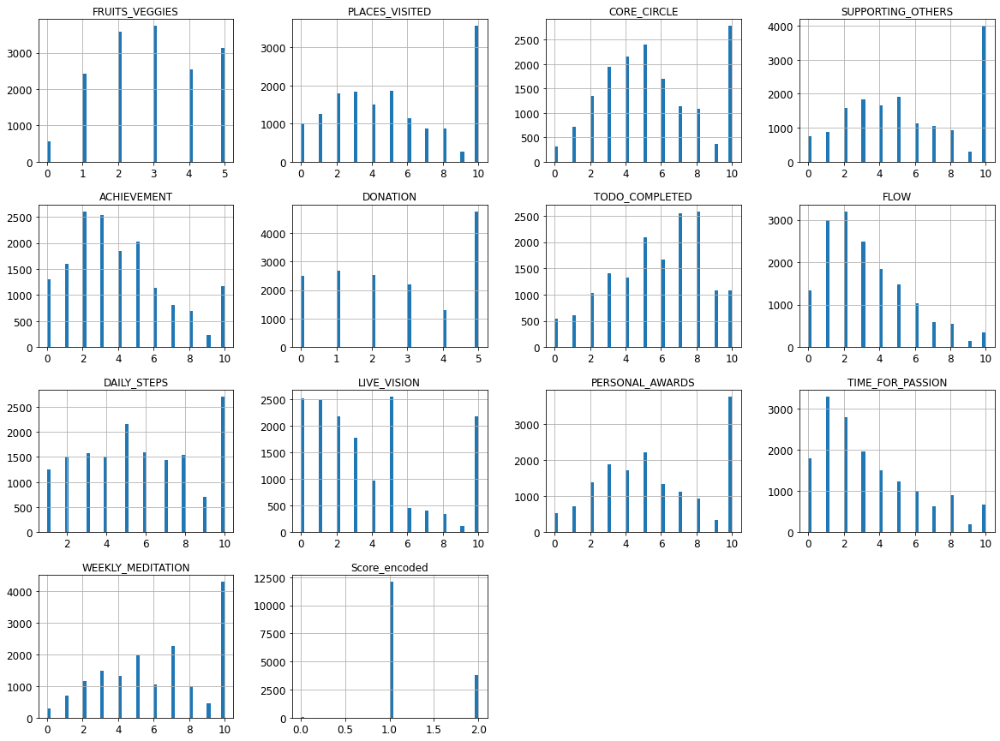

In [19]:
data_encoded.hist(bins=50, figsize=(20,15))
plt.show()

# E) Create 2 Datasets With Less Features 

In [14]:
# Making subclasses to analyse most correlating features of the dataset per class
subclass_0 = data_encoded[data_encoded['Score_encoded'] == 0]
subclass_1 = data_encoded[data_encoded['Score_encoded'] == 1]
subclass_2 = data_encoded[data_encoded['Score_encoded'] == 2]

# Datasets  process: contains 2 top features for each of 3 classes: 2*3 = 6 feature
# getting the first 2 features of class 0
corr_matrix_0 = subclass_0.corr().abs()
corr_matrix_1 = subclass_1.corr().abs()
corr_matrix_2 = subclass_2.corr().abs()

# matrix is symmetric, thus extract upper triangle matrix without diagonal(k = 1)
sol_0 = (corr_matrix_0.where(np.triu(np.ones(corr_matrix_0.shape), k=1).astype(bool))
                  .stack()
                  .sort_values(ascending= True))
sol_1 = (corr_matrix_1.where(np.triu(np.ones(corr_matrix_1.shape), k=1).astype(bool))
                  .stack()
                  .sort_values(ascending=True))
sol_2 = (corr_matrix_2.where(np.triu(np.ones(corr_matrix_2.shape), k=1).astype(bool))
                  .stack()
                  .sort_values(ascending=True))

#first items of sol are the pair with the lowest correlation
print(sol_0[:10])
print('--------------------------------------------')
print(sol_1[:10])
print('--------------------------------------------')
print(sol_2[:11])
print('--------------------------------------------')


FLOW               WEEKLY_MEDITATION    0.007862
SUPPORTING_OTHERS  WEEKLY_MEDITATION    0.011070
DAILY_STEPS        PERSONAL_AWARDS      0.012990
TIME_FOR_PASSION   WEEKLY_MEDITATION    0.018849
LIVE_VISION        PERSONAL_AWARDS      0.022832
DONATION           FLOW                 0.022980
CORE_CIRCLE        TIME_FOR_PASSION     0.023424
FRUITS_VEGGIES     ACHIEVEMENT          0.026976
PLACES_VISITED     DAILY_STEPS          0.028145
                   TODO_COMPLETED       0.033933
dtype: float64
--------------------------------------------
CORE_CIRCLE        WEEKLY_MEDITATION    0.003737
FRUITS_VEGGIES     LIVE_VISION          0.005642
SUPPORTING_OTHERS  WEEKLY_MEDITATION    0.011085
DAILY_STEPS        LIVE_VISION          0.018535
PLACES_VISITED     FLOW                 0.019714
DONATION           DAILY_STEPS          0.022942
DAILY_STEPS        TIME_FOR_PASSION     0.023840
FLOW               WEEKLY_MEDITATION    0.027344
DAILY_STEPS        PERSONAL_AWARDS      0.031049
SUPPORTIN

We can see that the correlation btw the target class and other features is NaN : (no correlation)
,because all the values of the target class are identical e.g. Score_encoded = [0,0,0,0,0]
If you look at the corr equation, corr = cov(x,y)/std(x) *std(y), you'll notice 
the standard deviation of x or y cannot be 0, becuase When you divide by zero, you get NaN, same as what's happening here.
thus we take the features that has lowest corr value, as they are not strongly correlated  

## E.1  Create Dataset 1, 2 & 3


In [14]:
# Making dataset 1 

# Take the features that has lowest corr value, as they are not strongly correlated

# for class 0: top 2 features are FLOW, WEEKLY_MEDITATION  
# for class 1: top 2 features are CORE_CIRCLE, WEEKLY_MEDITATION 
# for class 2: top 2 features are SUPPORTING_OTHERS, TODO_COMPLETED
# then we will have 5 features for the first dataset because the other features are repetitive 
dataset_1 = data_encoded[[ 'FLOW', 'WEEKLY_MEDITATION' ,'CORE_CIRCLE','SUPPORTING_OTHERS','TODO_COMPLETED','Score_encoded']]

# Making dataset 2

# for class 0: top 5 features are FLOW, WEEKLY_MEDITATION, SUPPORTING_OTHERS, DAILY_STEPS, PERSONAL_AWARDS
# for class 1: top 5 features are CORE_CIRCLE, WEEKLY_MEDITATION , FRUITS_VEGGIES, LIVE_VISION, SUPPORTING_OTHERS
# for class 2: top 5 features are SUPPORTING_OTHERS, TODO_COMPLETED, CORE_CIRCLE, LIVE_VISION, PLACES_VISITED
# then we will have 11 features for the first dataset because the other features are repetitive 
dataset_2 = data_encoded[['FLOW', 'WEEKLY_MEDITATION', 'SUPPORTING_OTHERS', 'DAILY_STEPS', 'PERSONAL_AWARDS',
                         'CORE_CIRCLE' , 'FRUITS_VEGGIES', 'LIVE_VISION', 
                          'TODO_COMPLETED', 'PLACES_VISITED','Score_encoded']]

# Making dataset 3

# for class 0: top 10 features are FLOW, WEEKLY_MEDITATION, SUPPORTING_OTHERS, DAILY_STEPS, PERSONAL_AWARDS, DONATION, 
# CORE_CIRCLE, TIME_FOR_PASSION, FRUITS_VEGGIES, ACHIEVEMENT

# for class 1: top 10 features are CORE_CIRCLE, WEEKLY_MEDITATION , FRUITS_VEGGIES, LIVE_VISION, SUPPORTING_OTHERS, 
# DAILY_STEPS, PLACES_VISITED, FLOW, DONATION,TIME_FOR_PASSION 

# for class 2: top 10 features are SUPPORTING_OTHERS, TODO_COMPLETED, CORE_CIRCLE, LIVE_VISION, PLACES_VISITED
# ACHIEVEMENT, DAILY_STEPS, WEEKLY_MEDITATION, DONATION, PERSONAL_AWARDS
# then we will have 16 features for the first dataset because the other features are repetitive 
dataset_3 = data_encoded[['FLOW', 'WEEKLY_MEDITATION', 'SUPPORTING_OTHERS', 'DAILY_STEPS', 'PERSONAL_AWARDS', 'DONATION',
                          'CORE_CIRCLE', 'TIME_FOR_PASSION', 'FRUITS_VEGGIES', 'ACHIEVEMENT',
                          'LIVE_VISION', 'PLACES_VISITED',
                          'TODO_COMPLETED', 'PLACES_VISITED','Score_encoded', 'ACHIEVEMENT']]

# Run Naïve Bayes classifier & Print Scores

************************* Start of Naïve Bayes Model Using Original Dataset *************************
*******************Accuracy*******************
The accuracy score of our model: 0.9136
The accuracy score of teh training set : 0.9097
***************Confusion matrix***************
Confusion matrix, without normalization
[[  15    0    0]
 [  63 3273  266]
 [   0   85 1090]]

True Positives(TP) =  3273

True Negatives(TN) =  1105

False Positives(FP): (Type I error)=  85

False Negatives(FN): (Type II error)=  63
***************Classification metrices***************
              precision    recall  f1-score   support

           0       0.19      1.00      0.32        15
           1       0.97      0.91      0.94      3602
           2       0.80      0.93      0.86      1175

    accuracy                           0.91      4792
   macro avg       0.66      0.95      0.71      4792
weighted avg       0.93      0.91      0.92      4792

Classification accuracy : 0.9673
Classificati

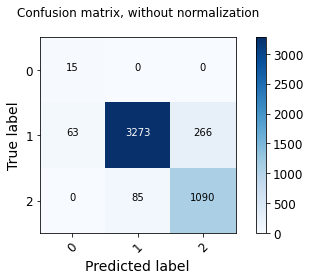

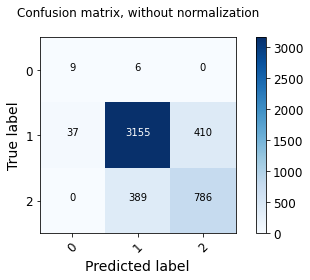

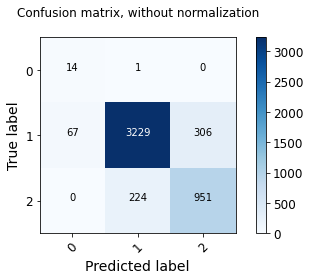

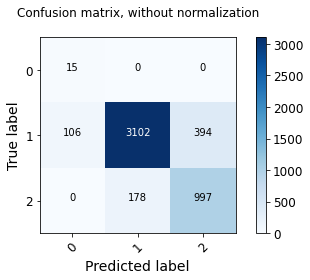

In [15]:
import matplotlib.pyplot as plt 
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB

def Run_Naive_Bays_Model(dataset):
    # Notes: 
    # True positives (TP): the cases for which the classifier predicted ‘spam’ and the emails were actually spam.
    # False positives (FP): the cases for which the classifier predicted ‘spam’ but the emails were actually real.
    # precision, recall, F, ROC area 
    # confusion_matrix

    # Split X and y into training and testing sets 70/30 

    X = dataset.drop(['Score_encoded'], axis=1)

    y = dataset['Score_encoded']

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 0)

    # check the shape of X_train and X_test
    X_train.shape, X_test.shape

    # train Gaussian Naive Bayes classifier on the training set
    # instantiate the model
    gnb = GaussianNB()

    # fit the model
    gnb.fit(X_train, y_train)

    # predict the result
    y_pred = gnb.predict(X_test)
    
    #------------------------------------------------------------
    # Check accuracy score, TP rate , FP rate, precision, recall, F measure, the ROC area
    from sklearn.metrics import accuracy_score

    # y_test : true class labels and y_pred : the predicted class labels in the test-set.
    print('*******************Accuracy*******************')
    print('The accuracy score of our model: {0:0.4f}'. format(accuracy_score(y_test, y_pred)))

    # to evaluate the overfitting and underfitting we compare the testing set and training set accuracy
    y_pred_train = gnb.predict(X_train)
    y_pred_train
    print('The accuracy score of teh training set : {0:0.4f}'. format(accuracy_score(y_train, y_pred_train)))

    # The training set accuracy score is 0.9124 and the testing set accuracy is 0.9132 
    # Hence the two values are quite comparable. therefore, there is no sign of overfitting model.

    print('***************Confusion matrix***************')
    from sklearn.metrics import confusion_matrix

    # we have used this function from the internet to plot the Confusion matrix and make it nice
    # https://datascience.stackexchange.com/questions/40067/confusion-matrix-three-classes-python/40068
    def plot_confusion_matrix(cm, classes,
                              normalize=False,
                              title='Confusion matrix',
                              cmap=plt.cm.Blues):
        import itertools
        if normalize:
            cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
            print("Normalized confusion matrix")
        else:
            print('Confusion matrix, without normalization')

        print(cm)

        plt.imshow(cm, interpolation='nearest', cmap=cmap)
        plt.title(title)
        plt.colorbar()
        tick_marks = np.arange(len(classes))
        plt.xticks(tick_marks, classes, rotation=45)
        plt.yticks(tick_marks, classes)

        fmt = '.2f' if normalize else 'd'
        thresh = cm.max() / 2.
        for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
            plt.text(j, i, format(cm[i, j], fmt),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")

        plt.ylabel('True label')
        plt.xlabel('Predicted label')
        plt.tight_layout()

    cm = confusion_matrix(y_test, y_pred, labels=[0, 1, 2])
    # Plot non-normalized confusion matrix
    plt.figure()
    plot_confusion_matrix(cm, classes=[0, 1, 2],
                          title='Confusion matrix, without normalization\n')

    TP = cm[1,1]
    print('\nTrue Positives(TP) = ', TP)
    TN = cm[0,0] + cm[0,2] + cm[2,0] + cm[2,2]
    print('\nTrue Negatives(TN) = ', TN)
    FP = cm[0,1] + cm[2,1]
    print('\nFalse Positives(FP): (Type I error)= ', FP)
    FN = cm[1,0] + cm[0,2]
    print('\nFalse Negatives(FN): (Type II error)= ', FN)

    # conclusion: 
    # confusion matrix shows 3272 + 1104 = 4376 correct predictions and 90 + 62 = 152 incorrect predictions.

    print('***************Classification metrices***************')
    # It displays the precision, recall, f1 and support scores 
    from sklearn.metrics import classification_report

    print(classification_report(y_test, y_pred))

    # classification accuracy
    classification_accuracy = (TP + TN) / float(TP + TN + FP + FN)
    print('Classification accuracy : {0:0.4f}'.format(classification_accuracy))

    # classification error
    classification_error = (FP + FN) / float(TP + TN + FP + FN)
    print('Classification error : {0:0.4f}'.format(classification_error))

    # precision score: the proportion of correctly predicted positive outcome, concerned with the positive class mainly 
    precision = TP / float(TP + FP)
    print('Precision : {0:0.4f}'.format(precision))

    # recall score: the proportion of correctly predicted actual positives.
    recall = TP / float(TP + FN)
    print('Recall or Sensitivity : {0:0.4f}'.format(recall))

    # F measure: provides a way to combine both precision and recall into a single measure that captures both properties.
    # Alone, neither precision or recall tells the whole story. 
    #  We can have excellent precision with terrible recall, or alternately, terrible precision with excellent recall.
    # F-measure provides a way to express both concerns with a single score.
    # it call be calculated as F-Measure = (2 * Precision * Recall) / (Precision + Recall)

    F_measure = (2 * precision * recall) / (precision + recall)
    print('F measure : {0:0.4f}'.format(F_measure))

    print('***************ROC AUC***************')

    # compute ROC AUC: Receiver Operating Characteristic - Area Under Curve. 
    from sklearn.metrics import roc_auc_score

    # compare classifier performance.we measure the area under the curve (AUC).The higher the value, the better the classifier.
    # perfect classifier have ROC AUC = 1, purely random classifier have ROC AUC = 0.5.

    y_prob = gnb.predict_proba(X_test)
    # One-vs-One scheme compares every unique pairwise combination of classes. 
    ROC_AUC = roc_auc_score(y_test, y_prob, multi_class="ovo")
    print('ROC AUC : {:.4f}'.format(ROC_AUC))

    # conclusion: our ROC AUC of the generared model is closer to 1.
    # Hence, we can say that our classifier does a good job in predicting whether the score of the work&life balance of a person
    # is poor, good, or excellent.

print('************************* Start of Naïve Bayes Model Using Original Dataset *************************')
Run_Naive_Bays_Model(data_encoded)
print('************************* End of Naïve Bayes Model Using Original Dataset *************************')
print('************************* Start of Naïve Bayes Model Using Dataset 1 *************************')
Run_Naive_Bays_Model(dataset_1)
print('************************* End of Naïve Bayes Model Using Dataset 1 *************************')
print('************************* Start of Naïve Bayes Model Using Dataset 2 *************************')
Run_Naive_Bays_Model(dataset_2)
print('************************* End of Naïve Bayes Model Using Dataset 2 *************************')
print('************************* Start of Naïve Bayes Model Using Dataset 3 *************************')
Run_Naive_Bays_Model(dataset_3)
print('************************* End of Naïve Bayes Model Using Dataset 3 *************************')

In [60]:
print(data_encoded_cluster.info())
print(data_original_cluster.info())
data_encoded_cluster.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15971 entries, 0 to 15970
Data columns (total 13 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       15971 non-null  float64
 1   1       15971 non-null  float64
 2   2       15971 non-null  float64
 3   3       15971 non-null  float64
 4   4       15971 non-null  float64
 5   5       15971 non-null  float64
 6   6       15971 non-null  float64
 7   7       15971 non-null  float64
 8   8       15971 non-null  float64
 9   9       15971 non-null  float64
 10  10      15971 non-null  float64
 11  11      15971 non-null  float64
 12  12      15971 non-null  float64
dtypes: float64(13)
memory usage: 1.6 MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15971 entries, 0 to 15970
Data columns (total 22 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       15971 non-null  float64
 1   1       15971 non-null  float64
 2   2       15971 non-null  floa

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,0.053599,-0.976294,-0.178965,-1.732407,-0.725985,-1.466473,0.096804,0.341727,-0.243371,-1.161311,-0.553915,-1.218845,-0.408970
1,-0.639548,-0.372383,-0.883141,0.735331,0.362618,-0.386266,-0.284280,-0.506733,-0.243371,0.386206,-0.877598,-0.485987,-0.077447
2,-0.639548,-0.674338,-0.531053,-0.498538,-0.363118,-0.386266,-1.427530,-0.506733,-0.589270,0.386206,-0.553915,1.712587,-1.072015
3,0.053599,1.439352,-0.883141,1.352265,-0.725985,1.234043,-1.046447,0.765957,-0.243371,-1.161311,-0.230232,-0.485987,-2.066583
4,1.439895,-0.674338,-0.883141,1.352265,-0.725985,0.693940,-0.284280,-1.355194,-0.243371,-1.161311,0.740817,-0.852416,-0.408970


# Part 2: Clustering 

# PRINCIPAL COMPONENT ANALYSIS


In [49]:
# we must fit our dataset using PCA
# the dataset that we want to work on is the new generated dataset that has 23 features, we reduced it 
# by selecting the most important features.

from sklearn.preprocessing import StandardScaler
from pandas import DataFrame
from sklearn.decomposition import PCA

# define standard scaler
scaler = StandardScaler()

# transform data
scaled = scaler.fit_transform(data_original_cluster)

# convert the array back to a dataframe
data_original_cluster = DataFrame(scaled)

pca = PCA()
pca.fit(data_original_cluster)

PCA()

Features on which the PCA-transformation is calculated should be normalized ( that means zero mean and unit variance), thus I prefer to use sklearns StandardScaler, because sklearns Normalizer is missing zero-mean, and Min-Max scaler method is missing unit-variance.

Standard Scaler: Transforms features independently to unit variance and zero centered.Its data value range is fixed between 0 and 1 . Most commonly used.

MInMax Scaler: Alternate to standard scaling which has agility to set the minimum and maximum range of data value. it's used when it is required to capture small variance in features and also for sparse data where zero value needs to be preserved.

In [50]:
# the attribute shows the veriance explained by each of the 23 components
pca.explained_variance_ratio_


array([0.18803744, 0.0780341 , 0.06070571, 0.05163754, 0.04944893,
       0.04704602, 0.04583661, 0.04188503, 0.04151518, 0.03993012,
       0.03766905, 0.03435152, 0.03319897, 0.03246487, 0.03123738,
       0.03008125, 0.02955596, 0.02837553, 0.02709022, 0.0253445 ,
       0.02463436, 0.02191972])

In [51]:
data_original_cluster.head()

,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,18,19,20,21
0,0.053599,-0.578819,-0.976294,-0.178965,-1.732407,-0.477572,-0.725985,-1.466473,-0.834683,0.096804,...,-1.161311,-0.035823,0.569258,0.773095,-1.63991,-0.553915,-1.218845,-0.408970,-0.056361,-0.787468
1,-0.639548,0.152304,-0.372383,-0.883141,0.735331,1.142362,0.362618,-0.386266,1.198059,-0.284280,...,0.386206,0.798194,-0.243364,-0.347874,0.60979,-0.877598,-0.485987,-0.077447,-0.056361,-0.787468
2,-0.639548,0.152304,-0.674338,-0.531053,-0.498538,1.142362,-0.363118,-0.386266,1.198059,-1.427530,...,0.386206,0.798194,1.923628,-0.347874,0.60979,-0.553915,1.712587,-1.072015,-0.056361,-0.787468
3,0.053599,0.152304,1.439352,-0.883141,1.352265,0.170402,-0.725985,1.234043,1.198059,-1.046447,...,-1.161311,-1.703858,1.111006,0.773095,-1.63991,-0.230232,-0.485987,-2.066583,0.920988,-0.787468
4,1.439895,-1.309943,-0.674338,-0.883141,1.352265,-0.801558,-0.725985,0.693940,1.198059,-0.284280,...,-1.161311,-0.035823,-0.785113,-1.095186,0.60979,0.740817,-0.852416,-0.408970,0.920988,-0.787468


[0.2897472  0.09372349 0.08150116 0.06754811 0.06407804 0.05938938
 0.05807582 0.05721355 0.05331105 0.05089872 0.0440262  0.04260645
 0.03788083]


Text(0, 0.5, 'Cumulative Explained Variance')

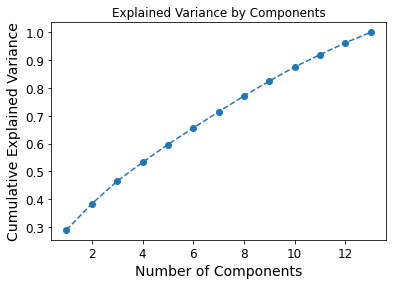

In [71]:
# transform data
scaled = scaler.fit_transform(data_encoded_cluster)

# convert the array back to a dataframe
data_encoded_cluster = DataFrame(scaled)

# PCA analysis on the reduced dataset
pca.fit(data_encoded_cluster)

# the attribute shows the veriance explained by each of the 13 components
print(pca.explained_variance_ratio_)

# we selected 15 based on the number of features
plt.plot(range(1,14), pca.explained_variance_ratio_.cumsum(), marker ='o', linestyle ='--')
plt.title('Explained Variance by Components')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')



## Research question:
We tried to fit the PCA on two different datasets
step 1: we took of the response class from the both datasets
the first dataset was the original datasets that has all features, while the other one was the dataset that we reduced the features that have weak correlation among themselves.

The above two graphs show the amount of variance captured (on the y-axis) depending on the number of components we include (the x-axis). The rule states that we preserve around 80 % of the variance. However, we can see that the combination of the first 8 PCs contribute ~80% So, and the first 3 PCs contribute ~50%, but it will be difficult to visualize them at once and needs to perform pairwise visualization. In this instance, we decide to retain just two components as they explain at least 40% of the total variation,and it will be easy for us to visulize it, and we will perform also pairwaise visualization. Additionally, the reduced datatest captured more variance than the orginial one. Hence, we will keep working on the reduced dataset. 

## Perform PCA on All Features

In [72]:
import bioinfokit
from bioinfokit.visuz import cluster

# first let's choose two components. 
#pca = PCA(n_components = 2)
pca = PCA().fit(data_encoded_cluster)

# fit the model on our reduced dataset with the selected number of compoenents. 
pca.fit(data_encoded_cluster)

# we take the resultig components scores for the elements in our dataset
scores_pca = pca.transform(data_encoded_cluster)
print(scores_pca)

# component loadings or weights (correlation coefficient between original variables and the component) 
# component loadings represents the elements of the eigenvector
# the squared loadings within the PCs always sums to 1
loadings = pca.components_
num_pc = pca.n_features_
pc_list = ["PC"+str(i) for i in list(range(1, num_pc+1))]
X2 = scores_pca[:,0:2]
X = scores_pca

[[-2.34354353 -0.00893884  1.0414966  ...  0.8149634  -0.32527542
   0.58957842]
 [-0.82521703  0.48683596 -0.03851282 ... -1.29623969 -0.62077283
   0.18483853]
 [-1.2630821   1.56706707  0.03238384 ... -0.13785818  0.77252675
  -1.30092579]
 ...
 [ 6.23298405  0.61515048  1.09170616 ...  0.53929894 -0.13890511
   0.17766335]
 [ 0.39424531  2.15847629  1.12811837 ...  1.42089526 -0.40111839
   0.95868652]
 [-0.12175929  1.82752671  0.89510763 ... -2.04627313 -0.21934338
  -0.52606294]]


## PCA loadings plots

In [54]:
# get PCA loadings plots (2D and 3D)
# 2D
cluster.pcaplot(x=loadings[0], y=loadings[1], labels=data_encoded_cluster.columns.values, 
    var1=round(pca.explained_variance_ratio_[0]*100, 2),
    var2=round(pca.explained_variance_ratio_[1]*100, 2))

# 3D
cluster.pcaplot(x=loadings[0], y=loadings[1], z=loadings[2],  labels=data_encoded_cluster.columns.values, 
    var1=round(pca.explained_variance_ratio_[0]*100, 2), var2=round(pca.explained_variance_ratio_[1]*100, 2), 
    var3=round(pca.explained_variance_ratio_[2]*100, 2))

loadings for a principal component represent the correlation between the variables and the principal components. 

## PCA biplot

Biplot: The PCA loadings and scores are plotted in a single figure

In [73]:
# get PC scores
pca_scores = PCA().fit_transform(data_encoded_cluster)

# get 2D biplot
cluster.biplot(cscore=pca_scores, loadings=loadings, labels=data_encoded_cluster.columns.values, 
                axlabelfontsize = 5, 
               var1=round(pca.explained_variance_ratio_[0]*100, 2),
               var2=round(pca.explained_variance_ratio_[1]*100, 2))
    
# get 3D biplot
cluster.biplot(cscore=pca_scores, loadings=loadings, labels=data_encoded_cluster.columns.values,
               dotsize = 1, colordot = "#ff0000", valphadot = 0.05, arrowlinewidth = 2,
               centerlines = True, axlabelfontsize = 5, 
    var1=round(pca.explained_variance_ratio_[0]*100, 2), 
    var2=round(pca.explained_variance_ratio_[1]*100, 2), 
    var3=round(pca.explained_variance_ratio_[2]*100, 2))

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,0.053599,-0.976294,-0.178965,-1.732407,-0.725985,-1.466473,0.096804,0.341727,-0.243371,-1.161311,-0.553915,-1.218845,-0.408970
1,-0.639548,-0.372383,-0.883141,0.735331,0.362618,-0.386266,-0.284280,-0.506733,-0.243371,0.386206,-0.877598,-0.485987,-0.077447
2,-0.639548,-0.674338,-0.531053,-0.498538,-0.363118,-0.386266,-1.427530,-0.506733,-0.589270,0.386206,-0.553915,1.712587,-1.072015
3,0.053599,1.439352,-0.883141,1.352265,-0.725985,1.234043,-1.046447,0.765957,-0.243371,-1.161311,-0.230232,-0.485987,-2.066583
4,1.439895,-0.674338,-0.883141,1.352265,-0.725985,0.693940,-0.284280,-1.355194,-0.243371,-1.161311,0.740817,-0.852416,-0.408970


loadings for a principal component represent the correlation between the variables and the principal components. 

For the 3D biplot: 
    In the loading plot for our data. We can observe that variables 7, 11, and 9 are moderately correlated (values close to 0.4 with PC2) and (values close to -0.2 with PC1) and (vlaues close to 0.2 with PC3). Thus, we can assume that variables 7, 11, and 9 are clustered closely together.
This is the same case as the other variables, as they all located close to 0.5 and 0.01. While variables 2, 3 and 10 have weak correlation with PC2 and PC3, but somehow corralted with PC1. The angle of these features is small, hence we can assume they form a cluster. 

Now let's visilaize thse assumptions to check if they're correct:


In [57]:
import plotly.express as px

# x= "TIME_FOR_PASSION", y="LIVE_VISION", color="FLOW"
fig1 = px.scatter(data_encoded_cluster, x= 7, y= 9, color= 11,marginal_x="box", marginal_y="box")
fig1.update_layout(title="3 Corrlated Features with the PC")
fig1.show()

# x= "CORE_CIRCLE", y="PLACES_VISITED", color="LIVE_VISION"
fig1 = px.scatter(data_encoded_cluster, x= 3 , y= 2, color= 10,marginal_x="box", marginal_y="box")
fig1.update_layout(title="3 Corrlated Features with the PC")
fig1.show()


then we will incorporate the newly obtained PCA scores in the K-means, this is how we perform 
segmentation based on PCA scores instead f the original features.

# Combine PCA & K-means Clustering

We used the scores obtained by the PCA for the fit. 

## K-Means Let's start by generating some blobs:

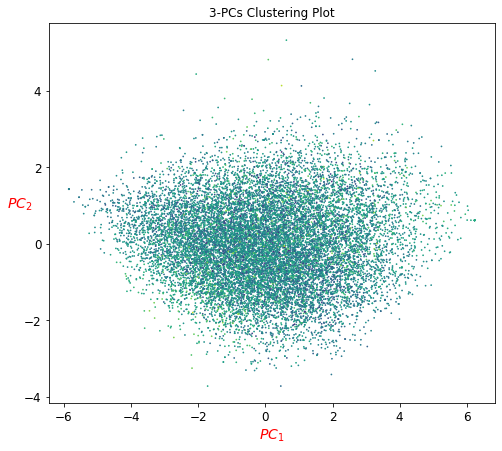

In [58]:
from sklearn.datasets import make_blobs

# 3D plot using 4 PCs 
fig2 = px.scatter_3d(X, x=X[:, 0], y=X[:, 1],z=X[:, 2], color=X[:, 3] )
fig2.update_layout(title="4-PCs Clustering Plot")
fig2.show()

#------------------------------------------------------------------

# 2D plot using 3 PCs
def plot_clusters(X):
    plt.scatter(X[:, 0], X[:, 1],c=X[:,2], s=0.5) #s is the size of dots.
    plt.xlabel("$PC_1$", fontsize=14, color='red')
    plt.ylabel("$PC_2$", fontsize=14, rotation=0, color='red')
    plt.title('3-PCs Clustering Plot')
    
plt.figure(figsize=(8, 7))
plot_clusters(X)
plt.show()

From the above plot, we can see that there is no obvious clusters that are occurring. It means, 3- PCs and 4-PCs failed to find clusters within our dataset.

## Fit and Predict

Let's train a K-Means clusterer on this dataset. It will try to find each blob's center and assign each instance to the closest blob:

fit_predict Compute cluster centers and predict cluster index for each sample.

In [74]:
from sklearn.cluster import KMeans

k = 3
kmeans = KMeans(n_clusters=k, random_state=42)
y_pred = kmeans.fit_predict(X2)
y_pred

array([2, 0, 2, ..., 1, 1, 0])

In [75]:
y_pred is kmeans.labels_

True

These are the following 6 centroids (cluster centers) were estimated:

In [76]:
kmeans.cluster_centers_

array([[ 0.06864658, -0.48360023],
       [ 2.34272424,  0.40479757],
       [-2.18638394,  0.30522675]])

In [77]:
kmeans.labels_

array([2, 0, 2, ..., 1, 1, 0])

## Decision Boundaries

Let's plot the model's decision boundaries. This gives us a Voronoi diagram:

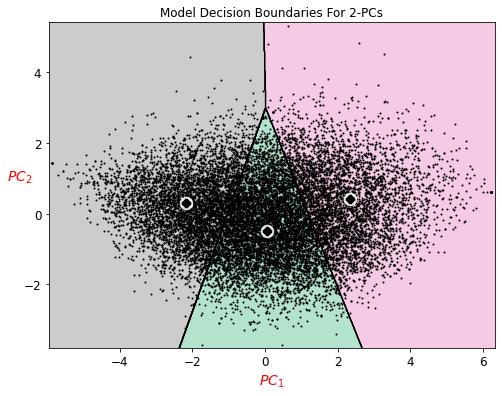

In [78]:
def plot_data(X):
    plt.plot(X[:, 0], X[:, 1], 'k.', markersize=2)
    plt.title('Model Decision Boundaries For 2-PCs')

def plot_centroids(centroids, weights=None, circle_color='w', cross_color='k'):
    if weights is not None:
        centroids = centroids[weights > weights.max() / 10]
    plt.scatter(centroids[:, 0], centroids[:, 1],
                marker='o', s=30, linewidths=8,
                color=circle_color, zorder=10, alpha=0.9)
    plt.scatter(centroids[:, 0], centroids[:, 1],
                marker='x', s=20, linewidths=8,
                color=cross_color, zorder=11, alpha=1)

def plot_decision_boundaries(clusterer, X, resolution=1000, show_centroids=True,
                             show_xlabels=True, show_ylabels=True):
    mins = X.min(axis=0) - 0.1
    maxs = X.max(axis=0) + 0.1
    xx, yy = np.meshgrid(np.linspace(mins[0], maxs[0], resolution),
                         np.linspace(mins[1], maxs[1], resolution))
    Z = clusterer.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)

    plt.contourf(Z, extent=(mins[0], maxs[0], mins[1], maxs[1]),
                cmap="Pastel2")
    plt.contour(Z, extent=(mins[0], maxs[0], mins[1], maxs[1]),
                linewidths=1, colors='k')
    plot_data(X)
    if show_centroids:
        plot_centroids(clusterer.cluster_centers_)

    if show_xlabels:
        plt.xlabel("$PC_1$", fontsize=14, color ='red')
    else:
        plt.tick_params(labelbottom=False)
    if show_ylabels:
        plt.ylabel("$PC_2$", fontsize=14, rotation=0, color ='red')
    else:
        plt.tick_params(labelleft=False)

# plot the figure
plt.figure(figsize=(8, 6))
plot_decision_boundaries(kmeans, X2)
plt.show()

The graph is odd and this is reasonable because the generated components look like one big cluster. However, we can see above that the points are mainly centered at the middle of the cluster and they disperse when we go further. 

## Hard Clustering vs Soft Clustering

Instead of assigning each instance to a single cluster, which is called hard clustering, 
it can be useful to give each instance a score per 
cluster, which is called soft clustering.

In [79]:
# Transforms X to a cluster-distance space.
kmeans.transform(X2)

array([[2.45844759, 4.70449608, 0.35128215],
       [1.31937052, 3.16900334, 1.37322877],
       [2.44514573, 3.78849702, 1.56356237],
       ...,
       [6.2614942 , 3.89594273, 8.42507034],
       [2.66206365, 2.62144219, 3.17713412],
       [2.31895713, 2.84566992, 2.56516513]])

## A) K-Means Algorithm

Change the hyperparameters:
Let's run the K-Means algorithm for 1, 2 and 3 iterations, to see how the centroids move around:

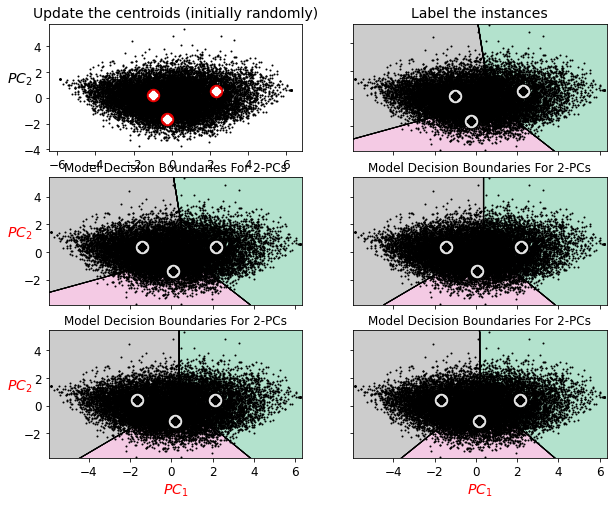

In [80]:
# this is the original K-Means algorithm 
kmeans_iter1 = KMeans(n_clusters=3, init="random", n_init=1,
                     algorithm="full", max_iter=1, random_state=1)
kmeans_iter2 = KMeans(n_clusters=3, init="random", n_init=1,
                     algorithm="full", max_iter=2, random_state=1)
kmeans_iter3 = KMeans(n_clusters=3, init="random", n_init=1,
                     algorithm="full", max_iter=3, random_state=1)
kmeans_iter1.fit(X2)
kmeans_iter2.fit(X2)
kmeans_iter3.fit(X2)

# To plot pretty figures

%matplotlib inline
import matplotlib as mpl
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

plt.figure(figsize=(10, 8))

plt.subplot(321)
plot_data(X)
plot_centroids(kmeans_iter1.cluster_centers_, circle_color='r', cross_color='w')
plt.ylabel("$PC_2$", fontsize=14, rotation=0)
plt.tick_params(labelbottom=True)
plt.title("Update the centroids (initially randomly)", fontsize=14)

plt.subplot(322)
plot_decision_boundaries(kmeans_iter1, X, show_xlabels=False, show_ylabels=False)
plt.title("Label the instances", fontsize=14)

plt.subplot(323)
plot_decision_boundaries(kmeans_iter1, X, show_centroids=False, show_xlabels=False)
plot_centroids(kmeans_iter2.cluster_centers_)

plt.subplot(324)
plot_decision_boundaries(kmeans_iter2, X, show_xlabels=False, show_ylabels=False)

plt.subplot(325)
plot_decision_boundaries(kmeans_iter2, X, show_centroids=False)
plot_centroids(kmeans_iter3.cluster_centers_)

plt.subplot(326)
plot_decision_boundaries(kmeans_iter3, X, show_ylabels=False)

plt.show()

This is totally makes sense, the centroids are close from the center of the clusters where the majority of the points located, and they get updated till it forms three clusters.

## K-Means Variability

In the original K-Means algorithm, the centroids are just initialized randomly, and the algorithm simply runs a single iteration to gradually improve the centroids, as we saw above.

However, one major problem with this approach is that if you run K-Means multiple times (or with different random seeds), it can converge to very different solutions, but in our dataset 
the case is not like that, because of the distribution of our dataset in a one big cluster.

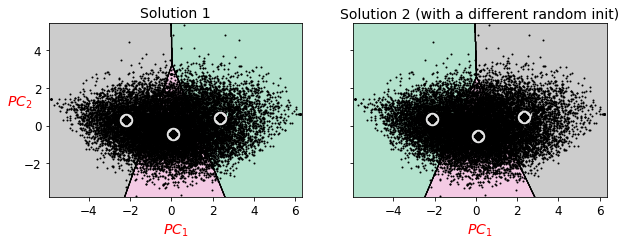

In [81]:
def plot_clusterer_comparison(clusterer1, clusterer2, X, title1=None, title2=None):
    clusterer1.fit(X)
    clusterer2.fit(X)

    plt.figure(figsize=(10, 3.2))

    plt.subplot(121)
    plot_decision_boundaries(clusterer1, X)
    if title1:
        plt.title(title1, fontsize=14)

    plt.subplot(122)
    plot_decision_boundaries(clusterer2, X, show_ylabels=False)
    if title2:
        plt.title(title2, fontsize=14)

kmeans_rnd_init1 = KMeans(n_clusters=3, init="random", n_init=1,
                         algorithm="full", random_state=44)
kmeans_rnd_init2 = KMeans(n_clusters=3, init="random", n_init=1,
                         algorithm="full", random_state=64)

plot_clusterer_comparison(kmeans_rnd_init1, kmeans_rnd_init2, X2,
                          "Solution 1", "Solution 2 (with a different random init)")
plt.show()

## Inertia

To select the best model, we will need a way to evaluate a K-Mean model's performance. Unfortunately, clustering is an unsupervised task, and we removed the target class to assume that we have unsupervised clustering. But at least we can measure the distance between each instance and its centroid. This is the idea behind the inertia metric:

In [35]:
kmeans.inertia_

32661.40644925665

Inertia is the sum of the squared distances between each training instance and its closest centroid:

In [36]:
X_dist = kmeans.transform(X2)
np.sum(X_dist[np.arange(len(X_dist)), kmeans.labels_]**2)

32661.406449256596

In [37]:
kmeans.score(X2)

-32661.40644925665

## Multiple Initializations|

So one approach to solve the variability issue is to simply run the K-Means algorithm multiple times with different random initializations, and select the solution that minimizes the inertia. For example, here are the inertias of the two "bad" models shown in the previous figure:

In [38]:
kmeans_rnd_init1.inertia_

32668.334399641408

In [39]:
kmeans_rnd_init2.inertia_

32662.314707535174

As you can see, they have a higher inertia than the first "good" model we trained, which means they are probably worse.

When you set the n_init hyperparameter, Scikit-Learn runs the original algorithm n_init times, and selects the solution that minimizes the inertia. By default, Scikit-Learn sets n_init=10.

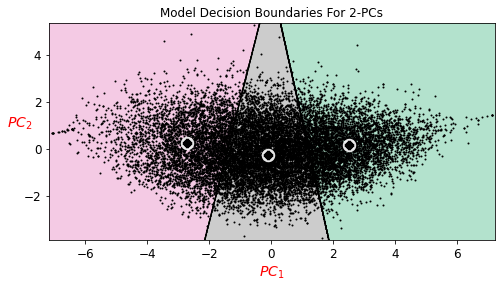

In [40]:
kmeans_rnd_10_inits = KMeans(n_clusters=3, init="random", n_init=10,
                              algorithm="full", random_state=11)
kmeans_rnd_10_inits.fit(X2)

# plot the figure of 
plt.figure(figsize=(8, 4))
plot_decision_boundaries(kmeans_rnd_10_inits, X2)
plt.show()

As you can see, we end up with the initial model, which is certainly the optimal K-Means solution (at least in terms of inertia, and assuming  k=3 ).

## Finding the optimal number of clusters

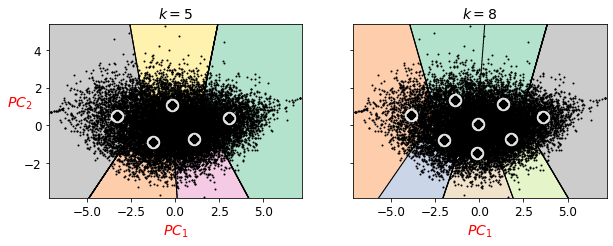

In [41]:
kmeans_k5 = KMeans(n_clusters=5, random_state=42)
kmeans_k8 = KMeans(n_clusters=8, random_state=42)

plot_clusterer_comparison(kmeans_k5, kmeans_k8, X2, "$k=5$", "$k=8$")
plt.show()

These two models don't look great.

In [42]:
kmeans_k5.inertia_

20416.34980165355

In [43]:
kmeans_k8.inertia_

13656.217166223832

No, we cannot simply take the value of 𝑘 that minimizes the inertia, since it keeps getting lower as we increase 𝑘 . Indeed, the more clusters there are, the closer each instance will be to its closest centroid, and therefore the lower the inertia will be. However, we can plot the inertia as a function of 𝑘 and analyze the resulting curve:

In [84]:
kmeans_per_k = [KMeans(n_clusters=k, random_state=42).fit(X2)
                for k in range(1, 15)]
inertias = [model.inertia_ for model in kmeans_per_k]

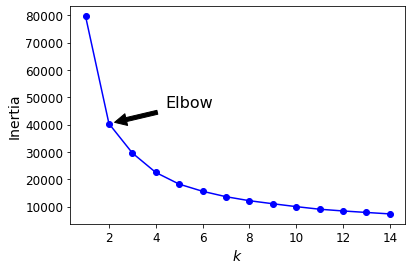

In [85]:
plt.plot(range(1, 15), inertias, "bo-")
plt.xlabel("$k$", fontsize=14)
plt.ylabel("Inertia", fontsize=14)
plt.annotate('Elbow',
             xy=(2, inertias[1]),
             xytext=(0.40, 0.60),
             textcoords='figure fraction',
             fontsize=16,
             arrowprops=dict(facecolor='black', shrink=0.1)
            )
plt.show()

As you can see, there is an elbow at  k=2 , which means that less clusters than that would be bad, and more clusters would not help much and might cut clusters in half. So  k=2  is a pretty good choice. Of course in here it is not perfect since the dataset looks like a big one cluster in its own but this is a pretty good clustering nonetheless.

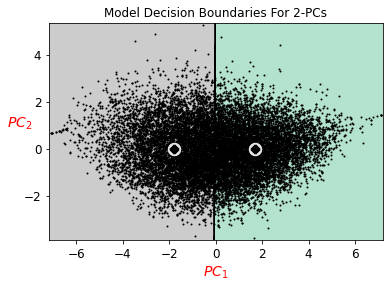

In [46]:
plot_decision_boundaries(kmeans_per_k[2-1], X2)
plt.show()

## Selecting number of clusters using silhouette plots

For n_clusters = 2 The average silhouette_score is : 0.4117699068276681
For n_clusters = 3 The average silhouette_score is : 0.33696305963589696
For n_clusters = 4 The average silhouette_score is : 0.35790833943157485
For n_clusters = 5 The average silhouette_score is : 0.34358467814100513
For n_clusters = 6 The average silhouette_score is : 0.3365419267688099


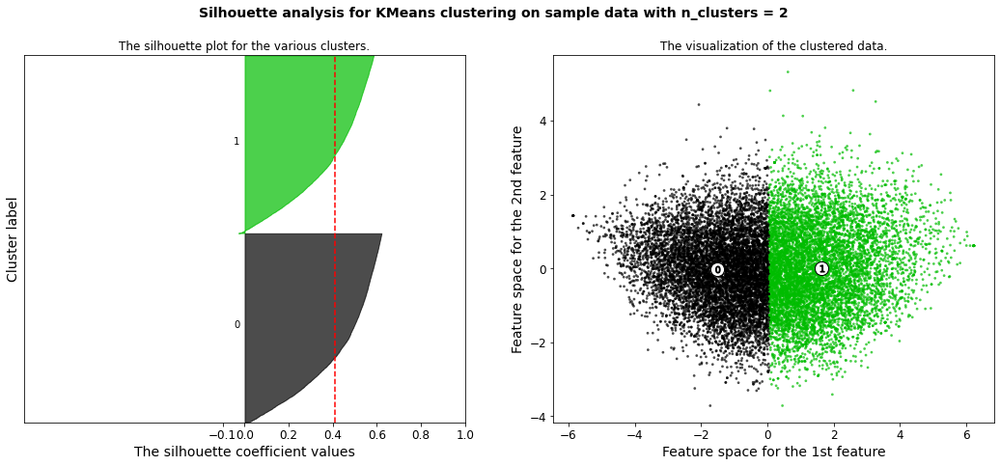

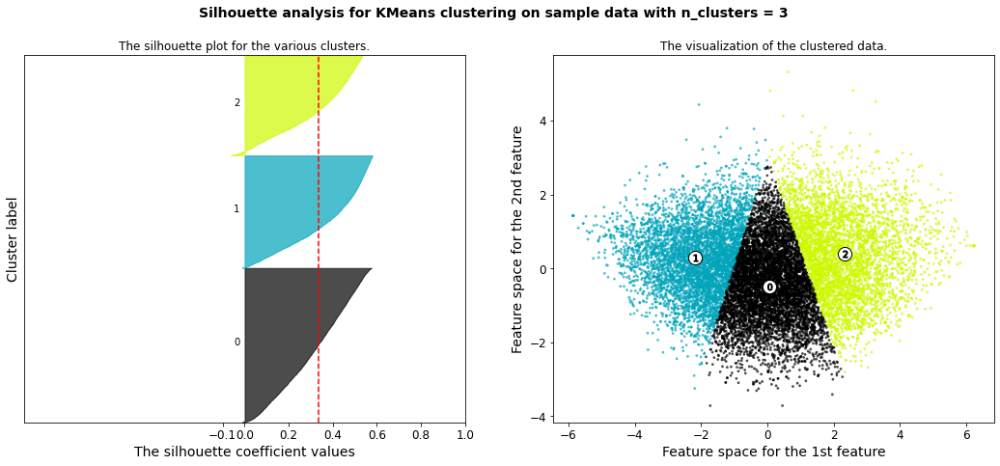

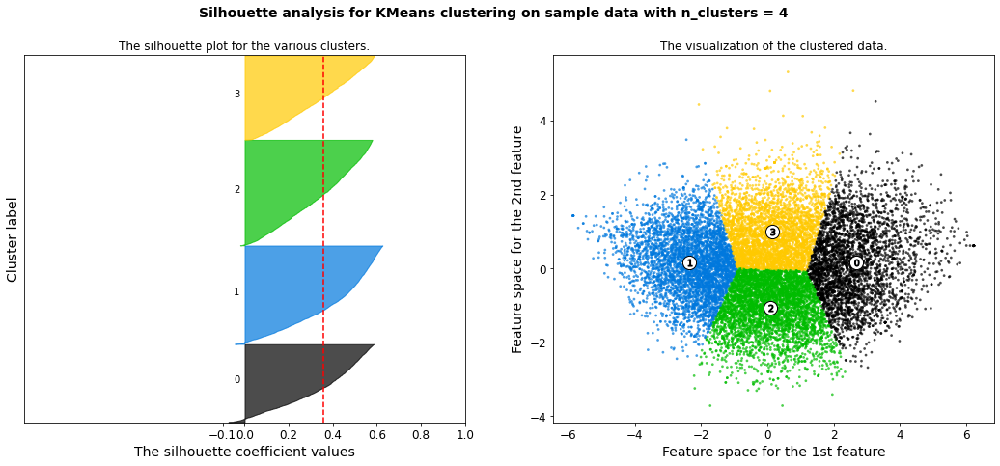

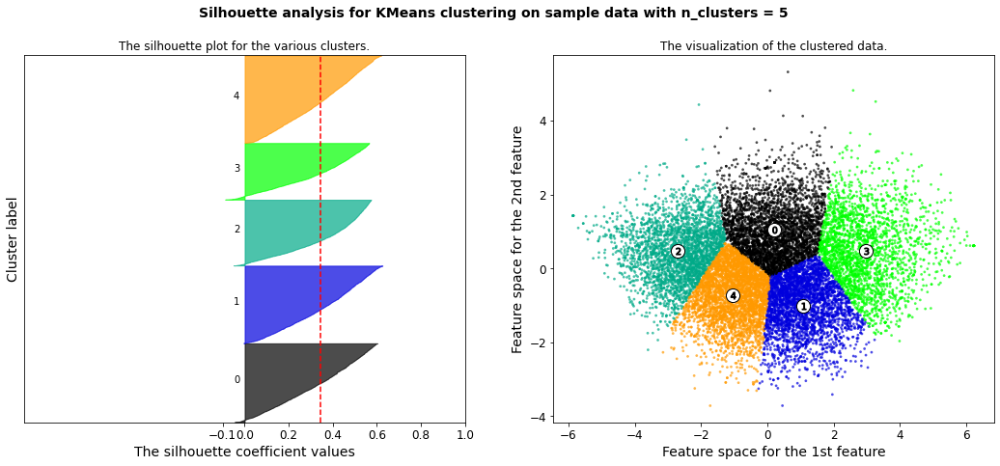

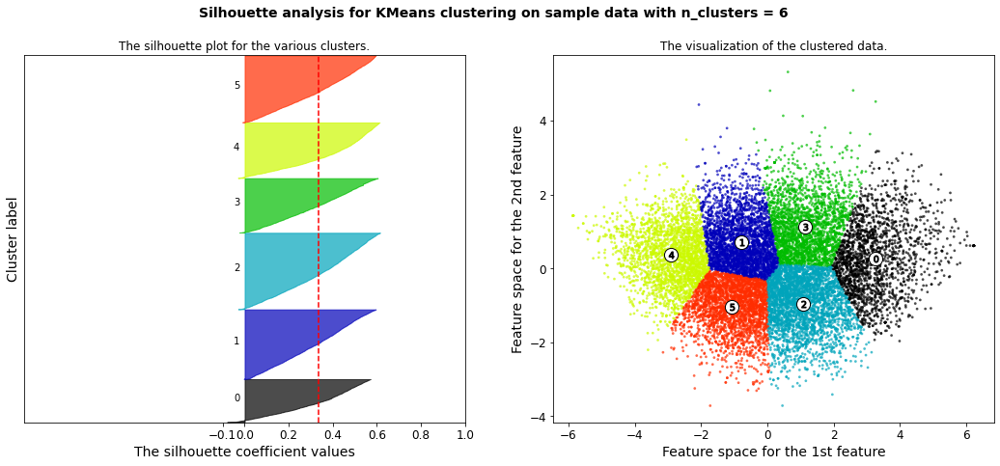

In [86]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X2) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X2)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X2, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X2, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

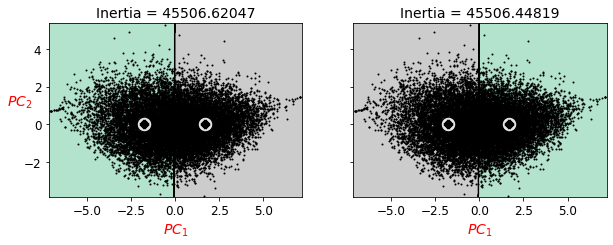

In [41]:
kmeans_good = KMeans(n_clusters=2, init=np.array([[-1.5, 2.5], [0.5, 0]]), n_init=1, random_state=42)
kmeans_bad = KMeans(n_clusters=2, random_state=42)
kmeans_good.fit(X2)
kmeans_bad.fit(X2)

plt.figure(figsize=(10, 3.2))

plt.subplot(121)
plot_decision_boundaries(kmeans_good, X2)
plt.title("Inertia = {:.5f}".format(kmeans_good.inertia_), fontsize=14)

plt.subplot(122)
plot_decision_boundaries(kmeans_bad, X2, show_ylabels=False)
plt.title("Inertia = {:.5f}".format(kmeans_bad.inertia_), fontsize=14)


plt.show()

## B) Hierarchical Clustering

Let’s first draw the dendrogram to help us decide the number of clusters

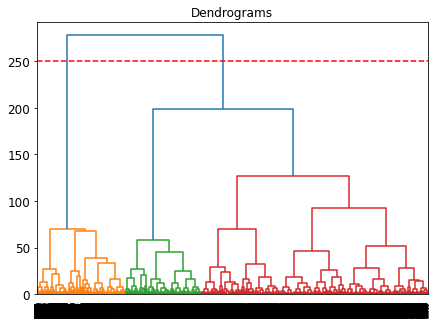

In [325]:
import scipy.cluster.hierarchy as shc

plt.figure(figsize=(7, 5))  
plt.title("Dendrograms")  
dend = shc.dendrogram(shc.linkage(X2, method='ward'))
plt.axhline(y=250, color='r', linestyle='--')

Set the threshold in such a way that it cuts the tallest vertical line.Thus, we can see that the tallest vertical line is the blue, and the threshold as 210.
Now We have two clusters as this line cuts the dendrogram at two points. 
Let’s now apply hierarchical clustering for 2 clusters:

In [324]:
from sklearn.cluster import AgglomerativeClustering
import sklearn.metrics as sm

cluster = AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward')  
cluster.fit_predict(X2)

array([0, 0, 0, ..., 1, 0, 0], dtype=int64)

We can see the values of 0s and 1s in the output since we defined 2 clusters.
0 represents the points that belong to the first cluster and 1 represents points 
in the second cluster. 

Agglomerative Clustering: silhouttte for 2 clusters:  0.15455105818487339


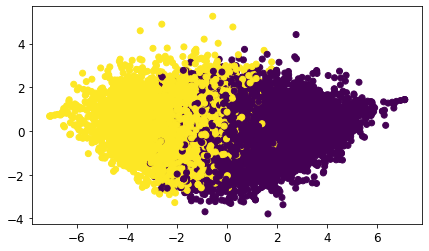

In [322]:
# visualize the two clusters 

plt.figure(figsize=(7, 4))  
plt.scatter(X[:, 0], X[:, 1], c=cluster.labels_) 

# for evaluate the accuracy 
pred = cluster.fit_predict(X2)
print ("Agglomerative Clustering: silhouttte for 2 clusters: ", silhouette_score(X2, pred))

Agglomerative Clustering: silhouttte for 3 clusters:  0.32202419974688723


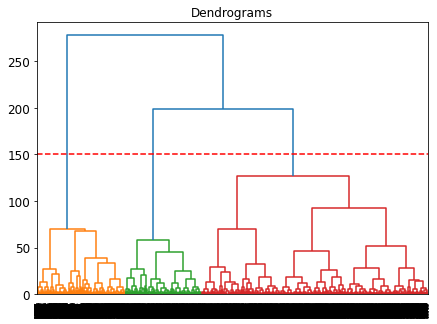

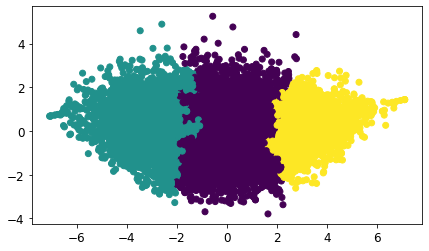

In [326]:
#************************************************************
# Hierarchical research analysis on 3 clusters 

plt.figure(figsize=(7, 5))  
plt.title("Dendrograms")  
dend = shc.dendrogram(shc.linkage(X2, method='ward'))
plt.axhline(y=150, color='r', linestyle='--')

cluster = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')  
cluster.fit_predict(X2)

# visualize the two clusters 
plt.figure(figsize=(7, 4))  
plt.scatter(X[:, 0], X[:, 1], c=cluster.labels_) 

# for evaluate the accuracy 
pred = cluster.fit_predict(X2)
print ("Agglomerative Clustering: silhouttte for 3 clusters: ", silhouette_score(X2, pred))

## C) Gaussian Mixture Model

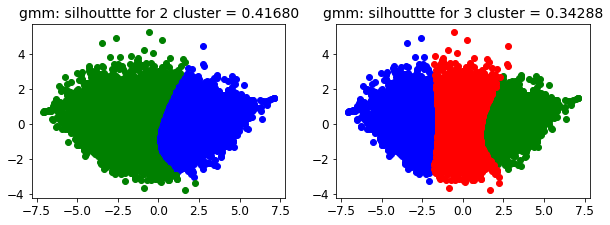

In [327]:
from sklearn.mixture import GaussianMixture

# because our dataset shows that the best number of clustering is 2 then we choose the n_component =2
gmm = GaussianMixture(n_components=2)
gmm.fit(X2)

#predictions from gmm
labels = gmm.predict(X2)
frame = pd.DataFrame(X2)
frame['cluster'] = labels
frame.columns = ['x1', 'x2', 'cluster']

# for evaluate the accuracy 
pred = gmm.predict(X2)

# for plotting the GMM clustering
plt.figure(figsize=(10, 3.2))

plt.subplot(121)
color=['blue','green']
for k in range(0,2):
    data = frame[frame["cluster"]==k]
    plt.scatter(data["x1"],data["x2"],c=color[k])
    plt.title("gmm: silhouttte for 2 cluster = {:.5f}".format(silhouette_score(X2, pred)),
              fontsize=14)


#************************************************************
# GMM research analysis on 3 clusters 
gmm = GaussianMixture(n_components=3)
gmm.fit(X2)

#predictions from gmm
labels = gmm.predict(X2)
frame = pd.DataFrame(X2)
frame['cluster'] = labels
frame.columns = ['x1', 'x2', 'cluster']

# for evaluate the accuracy 
pred = gmm.predict(X2)

# for plotting the GMM clustering
plt.subplot(122)
color=['blue','green', 'red']
for k in range(0,3):
    data = frame[frame["cluster"]==k]
    plt.title("gmm: silhouttte for 3 cluster = {:.5f}".format( silhouette_score(X2, pred)),
              fontsize=14)
    plt.scatter(data["x1"],data["x2"],c=color[k])
plt.show()



## E) Affinity Propagation Clustering 

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\cluster\_affinity_propagation.py:148: FutureWarning:

'random_state' has been introduced in 0.23. It will be set to None starting from 1.0 (renaming of 0.25) which means that results will differ at every function call. Set 'random_state' to None to silence this warning, or to 0 to keep the behavior of versions <0.23.



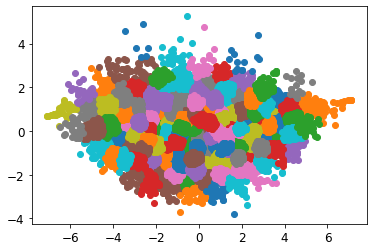

Text(0.5, 1.0, 'AffinityPropagation: silhouttte 0.32627')

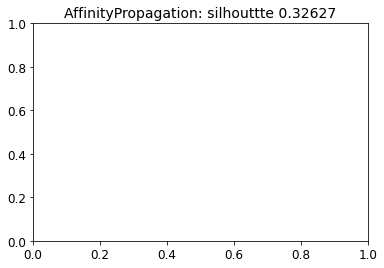

In [330]:
from numpy import unique
from numpy import where
from sklearn.datasets import make_classification
from sklearn.cluster import AffinityPropagation
from matplotlib import pyplot

# define the model
model = AffinityPropagation(damping=0.9)

# fit the model
model.fit(X2)

# assign a cluster to each example
yhat = model.predict(X2)

# retrieve unique clusters
clusters = unique(yhat)

# create scatter plot for samples from each cluster
for cluster in clusters:
    # get row indexes for samples with this cluster
    row_ix = where(yhat == cluster)
    # create scatter of these samples
    pyplot.scatter(X2[row_ix, 0], X2[row_ix, 1])
    pyplot.title("AffinityPropagation: silhouttte {:.5f}".format( silhouette_score(X2, yhat)),
              fontsize=14)
# show the plot
pyplot.show()


## F) BIRCH Clustering 

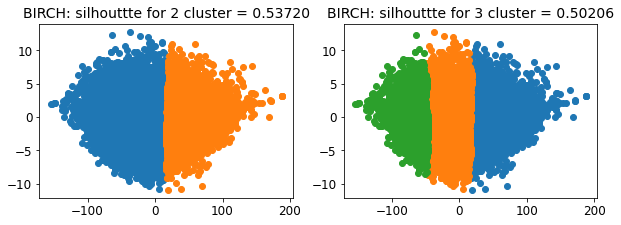

In [465]:
from numpy import unique
from numpy import where
from sklearn.datasets import make_classification
from sklearn.cluster import Birch

# define the model
model = Birch(threshold=0.01, n_clusters=2)

# fit the model
model.fit(X2)

# assign a cluster to each example
pred = model.predict(X2)

# retrieve unique clusters
clusters = unique(pred)

# create scatter plot for samples from each cluster
plt.figure(figsize=(10, 3.2))
plt.subplot(121)
for cluster in clusters:
    # get row indexes for samples with this cluster
    row_ix = where(pred == cluster)
    # create scatter of these samples
    plt.scatter(X2[row_ix, 0], X2[row_ix, 1])
    plt.title("BIRCH: silhouttte for 2 cluster = {:.5f}".format(silhouette_score(X2, pred)),
              fontsize=14)

#************************************************************
# Hierarchical research analysis on 3 clusters 

# define the model
model = Birch(threshold=0.01, n_clusters=3)

# fit the model
model.fit(X2)

# assign a cluster to each example
pred = model.predict(X2)

# retrieve unique clusters
clusters = unique(pred)

# create scatter plot for samples from each cluster
plt.subplot(122)
for cluster in clusters:
    # get row indexes for samples with this cluster
    row_ix = where(pred == cluster)
    # create scatter of these samples
    plt.scatter(X2[row_ix, 0], X2[row_ix, 1])
    plt.title("BIRCH: silhouttte for 3 cluster = {:.5f}".format( silhouette_score(X2, pred)),
              fontsize=14)
# show the plot
pyplot.show()

## G) DBSCAN Clustering 

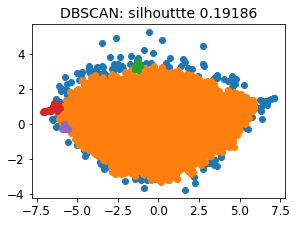

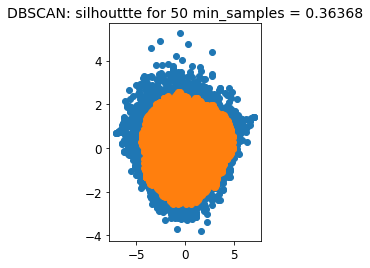

In [48]:
from numpy import unique
from numpy import where
from sklearn.datasets import make_classification
from sklearn.cluster import DBSCAN

# define the model
model = DBSCAN(eps=0.30, min_samples=10)

# fit model and predict clusters
pred = model.fit_predict(X2)

# retrieve unique clusters
clusters = unique(pred)

# create scatter plot for samples from each cluster
plt.figure(figsize=(10, 3.2))
plt.subplot(121)

for cluster in clusters:
    # get row indexes for samples with this cluster
    row_ix = where(pred == cluster)
    # create scatter of these samples
    plt.scatter(X2[row_ix, 0], X2[row_ix, 1])
    plt.title("DBSCAN: silhouttte {:.5f}".format( silhouette_score(X2, pred)),
              fontsize=14)

#************************************************************
# DBSCAN research analysis on 20 min_samples 

# define the model
model = DBSCAN(eps=0.30, min_samples=50)

# fit model and predict clusters
pred = model.fit_predict(X2)

# retrieve unique clusters
clusters = unique(pred)

# create scatter plot for samples from each cluster
plt.subplot(122)
for cluster in clusters:
    # get row indexes for samples with this cluster
    row_ix = where(pred == cluster)
    # create scatter of these samples
    plt.scatter(X2[row_ix, 0], X2[row_ix, 1])
    plt.title("DBSCAN: silhouttte for 50 min_samples = {:.5f}".format(silhouette_score(X2, pred)),
              fontsize=14)
# show the plot
plt.show()

## H) Spectral Clustering

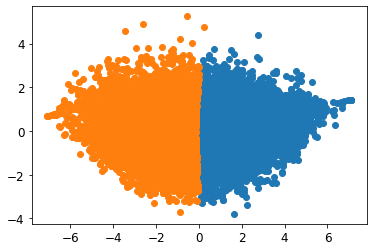

In [49]:
from numpy import unique
from numpy import where
from sklearn.datasets import make_classification
from sklearn.cluster import SpectralClustering
from matplotlib import pyplot

# define the model
model = SpectralClustering(n_clusters=2)

# fit model and predict clusters
yhat = model.fit_predict(X2)

# retrieve unique clusters
clusters = unique(yhat)

# create scatter plot for samples from each cluster
for cluster in clusters:
    # get row indexes for samples with this cluster
    row_ix = where(yhat == cluster)
    # create scatter of these samples
    pyplot.scatter(X2[row_ix, 0], X2[row_ix, 1])

# show the plot
pyplot.show()

# Part 3: Decision Tree

## Finding Important Features

By looking at the feature importance you can decide which features to possibly drop because they don’t contribute enough (or sometimes nothing at all) to the prediction process. This is important because a general rule in machine learning is that the more features you have the more likely your model will suffer from overfitting and vice versa.

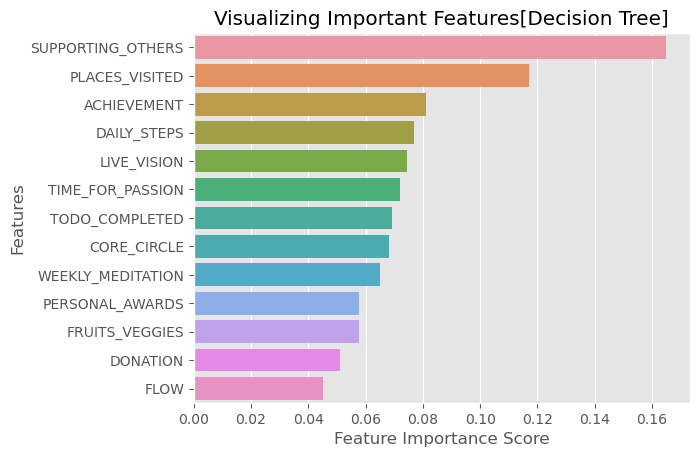

In [114]:
from sklearn.tree import DecisionTreeClassifier, plot_tree

# to make this notebook's output stable across runs
np.random.seed(42)

# Split to X and y 
X = data_encoded.drop(['Score_encoded'], axis=1)
X = X.drop(['WORK_LIFE_BALANCE_SCORE'], axis=1)

y = data_encoded['Score_encoded']

# Create Decision Tree classifer object
clf = DecisionTreeClassifier()

# Train Decision Tree Classifer
clf = clf.fit(X,y)

feature_imp = pd.Series(clf.feature_importances_,index=X.columns).sort_values(ascending=False)
feature_imp

# Creating a bar plot
sns.barplot(x=feature_imp, y=feature_imp.index)
# Add labels to your graph
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title("Visualizing Important Features[Decision Tree]")
plt.show()

To avoid overfitting, we will only take the top 10 features that contribute the most in accurate feature prediction

[['SUPPORTING_OTHERS','PLACES_VISITED','TODO_COMPLETED', 'ACHIEVEMENT','DAILY_STEPS',
'WEEKLY_MEDITATION','LIVE_VISION','CORE_CIRCLE','TIME_FOR_PASSION','PERSONAL_AWARDS']]

## Finding Optimal Depth via K-fold Cross-Validation

The depth-8 tree achieves the best mean cross-validation accuracy 84.69131 +/- std:3.68227% on training dataset


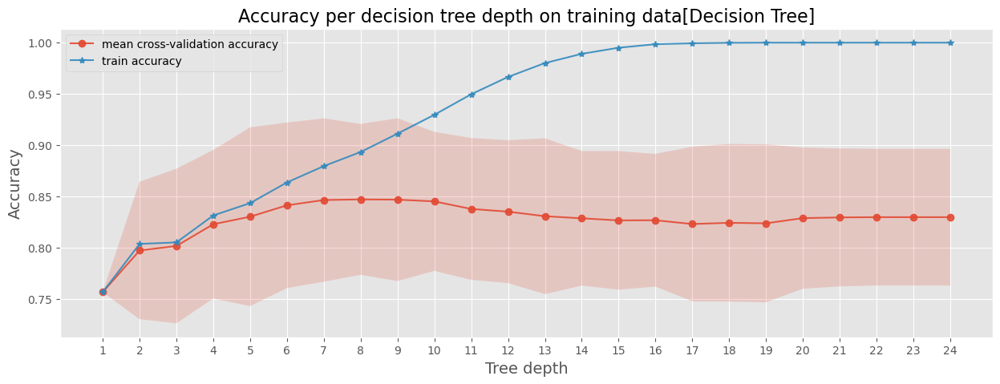

In [116]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import cross_val_score
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Split to X and y 
X = data_encoded[['SUPPORTING_OTHERS','PLACES_VISITED','TODO_COMPLETED', 'ACHIEVEMENT','DAILY_STEPS',
                  'WEEKLY_MEDITATION','LIVE_VISION','CORE_CIRCLE','TIME_FOR_PASSION','PERSONAL_AWARDS']]

y = data_encoded['Score_encoded']

# function for fitting trees of various depths on the training data using cross-validation
# Gini impurity is used to decide the variables based on which root node and following decision nodes should be split
# entropy
def run_cross_validation_on_trees(X, y, tree_depths, cv=10, criterion='gini', scoring='accuracy'):
    cv_scores_list = []
    cv_scores_std = []
    cv_scores_mean = []
    accuracy_scores = []
    for depth in tree_depths:
        tree_model = DecisionTreeClassifier(criterion=criterion, max_depth=depth,random_state=42)
        cv_scores = cross_val_score(tree_model, X, y, cv=cv, scoring=scoring)
        cv_scores_list.append(cv_scores)
        cv_scores_mean.append(cv_scores.mean())
        cv_scores_std.append(cv_scores.std())
        accuracy_scores.append(tree_model.fit(X, y).score(X, y))
    cv_scores_mean = np.array(cv_scores_mean)
    cv_scores_std = np.array(cv_scores_std)
    accuracy_scores = np.array(accuracy_scores)
    return cv_scores_mean, cv_scores_std, accuracy_scores
  
# function for plotting cross-validation results
def plot_cross_validation_on_trees(depths, cv_scores_mean, cv_scores_std, accuracy_scores, title):
    fig, ax = plt.subplots(1,1, figsize=(15,5))
    ax.plot(depths, cv_scores_mean, '-o', label='mean cross-validation accuracy', alpha=0.9)
    ax.fill_between(depths, cv_scores_mean-2*cv_scores_std, cv_scores_mean+2*cv_scores_std, alpha=0.2)
    ax.plot(depths, accuracy_scores, '-*', label='train accuracy', alpha=0.9)
    ax.set_title(title, fontsize=16)
    ax.set_xlabel('Tree depth', fontsize=14)
    ax.set_ylabel('Accuracy', fontsize=14)
    ax.set_xticks(depths)
    ax.legend()

# fitting trees of depth 1 to 24
sm_tree_depths = range(1,25)
sm_cv_scores_mean, sm_cv_scores_std, sm_accuracy_scores = run_cross_validation_on_trees(X,y, sm_tree_depths)
# plotting accuracy
plot_cross_validation_on_trees(sm_tree_depths, sm_cv_scores_mean, sm_cv_scores_std, sm_accuracy_scores, 
                               'Accuracy per decision tree depth on training data[Decision Tree]')

idx_max = sm_cv_scores_mean.argmax()
sm_best_tree_depth = sm_tree_depths[idx_max]
sm_best_tree_cv_score = sm_cv_scores_mean[idx_max]
sm_best_tree_cv_score_std = sm_cv_scores_std[idx_max]
print('The depth-{} tree achieves the best mean cross-validation accuracy {} +/- std:{}% on training dataset'.format(
      sm_best_tree_depth, round(sm_best_tree_cv_score*100,5), round(sm_best_tree_cv_score_std*100, 5)))



Thus, we will be using depth = 8, as it's the optimal depth for our dataset

## Building Decision Tree Model ( Without CrossValidation)

Classification report - 
               precision    recall  f1-score   support

           0       0.47      0.42      0.44        19
           1       0.90      0.90      0.90      3589
           2       0.71      0.69      0.70      1184

    accuracy                           0.85      4792
   macro avg       0.69      0.67      0.68      4792
weighted avg       0.85      0.85      0.85      4792



Text(0.5, 1.0, '**gini Decision Tree Model**')

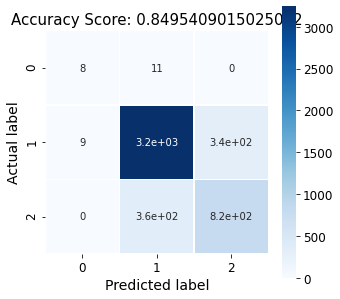

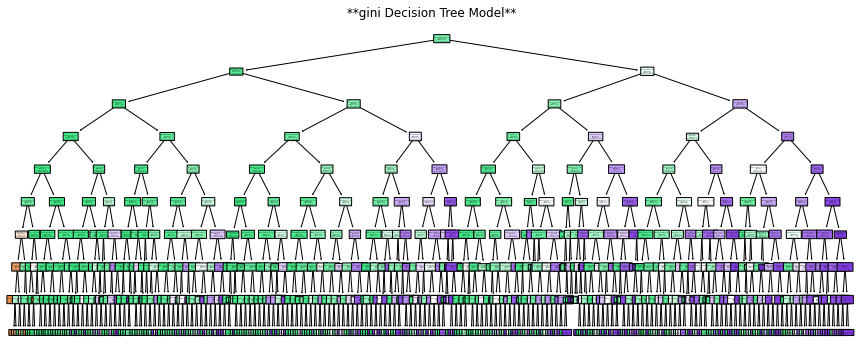

In [42]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

#Random Split the dataset to training and test datasets 70/30 
# for research question change it to 0.6
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3);

# Create Decision Tree classifer object
clf = DecisionTreeClassifier(max_depth =9,random_state=42)

# Train Decision Tree Classifer
clf = clf.fit(X_train,y_train)

#Predict the response for test dataset
y_pred = clf.predict(X_test)

print("Classification report - \n", classification_report(y_test,y_pred))

# Plot the confusion matrix as follows
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(5,5))
sns.heatmap(data=cm,linewidths=.5, annot=True,square = True,  cmap = 'Blues')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Accuracy Score: {0}'.format(clf.score(X_test, y_test))
plt.title(all_sample_title, size = 15)

#******************************************************************************************
# Plot the DT
plt.figure(figsize=(15, 6))
plot_tree(clf, class_names=['Poor','Good','Excellent'], 
          feature_names= X_train.columns,
          rounded=True, filled=True)
plt.title("**gini Decision Tree Model**")


We got an accuracy of 84% on the testing dataset of 4792 records.

## Building Decision Tree Model (With CrossValidation)

Due to the sake of the simplicity we have pruned the tree to a maximum depth of two as the accuracy doens't change as you can see from the above figure. 

In [122]:
from numpy import mean

scoring = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

# gini DT scores 
print("-- 10-fold cross-validation for 9-depth **gini** DT --")
print("---------------------------------------------------")
tree_clf_2_g = DecisionTreeClassifier(criterion='gini',max_depth=9, random_state=42)
tree_clf_2_g.fit(X,y)
scores = cross_validate(estimator=tree_clf_2_g, X=X, y=y, cv=10, scoring=scoring,
                            return_train_score=True)  

#Predict the response for test dataset
y_pred = tree_clf_2_g.predict(X)

print("Classification report **gini**- \n", classification_report(y,y_pred))
print('Test_accuracy: {}'.format(mean(scores['test_accuracy'])))
print('Train_accuracy: {}'.format(mean(scores['train_accuracy'])))
print('Test_precision_macro: {}'.format(mean(scores['test_precision_macro'])))
print('Train_precision_macro: {}'.format(mean(scores['train_precision_macro'])))
print('Test_recall_macro: {}'.format(mean(scores['test_recall_macro'])))
print('Train_recall_macro: {}'.format(mean(scores['train_recall_macro'])))
print('Test_f1_macro: {}'.format(mean(scores['test_f1_macro'])))
print('Train_f1_macro: {}'.format(mean(scores['train_f1_macro'])))

print('\n*********************************************************************************************')

# gini entropy scores
print("\n-- 10-fold cross-validation for 9-depth **entropy** DT --")
print("---------------------------------------------------")

tree_clf_2_e = DecisionTreeClassifier(criterion='entropy',max_depth=9, random_state=42)
tree_clf_2_e.fit(X, y)
scores = cross_validate(estimator=tree_clf_2_e, X=X, y=y, cv=10, scoring=scoring,
                            return_train_score=True)

#Predict the response for test dataset
y_pred = tree_clf_2_e.predict(X)

print("Classification report **entropy**- \n", classification_report(y,y_pred))
print("Classification report **gini**- \n", classification_report(y,y_pred))
print('Test_accuracy: {}'.format(mean(scores['test_accuracy'])))
print('Train_accuracy: {}'.format(mean(scores['train_accuracy'])))
print('Test_precision_macro: {}'.format(mean(scores['test_precision_macro'])))
print('Train_precision_macro: {}'.format(mean(scores['train_precision_macro'])))
print('Test_recall_macro: {}'.format(mean(scores['test_recall_macro'])))
print('Train_recall_macro: {}'.format(mean(scores['train_recall_macro'])))
print('Test_f1_macro: {}'.format(mean(scores['test_f1_macro'])))
print('Train_f1_macro: {}'.format(mean(scores['train_f1_macro'])))

-- 10-fold cross-validation for 9-depth **gini** DT --
---------------------------------------------------


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification report **gini**- 
               precision    recall  f1-score   support

           0       0.72      0.42      0.53        74
           1       0.93      0.95      0.94     12081
           2       0.84      0.79      0.82      3816

    accuracy                           0.91     15971
   macro avg       0.83      0.72      0.76     15971
weighted avg       0.91      0.91      0.91     15971

Test_accuracy: 0.84666258621649
Train_accuracy: 0.914143040316141
Test_precision_macro: 0.6567894924055582
Train_precision_macro: 0.8589913565790317
Test_recall_macro: 0.6293228319019629
Train_recall_macro: 0.7220338492732826
Test_f1_macro: 0.6305887844876534
Train_f1_macro: 0.7692262525954385

*********************************************************************************************

-- 10-fold cross-validation for 9-depth **entropy** DT --
---------------------------------------------------
Classification report **entropy**- 
               precision    recall  f1-score   s

Feature importance refers to a technique for assigning scores to input features of a predictive model that indicates the relative importance of each feature when making a prediction.

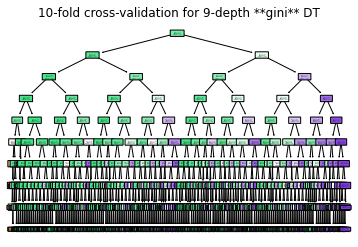

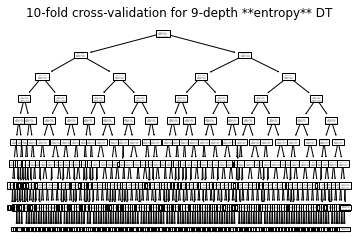

In [49]:
plot_tree(tree_clf_2_g,rounded=True, filled=True);
plt.title("10-fold cross-validation for 9-depth **gini** DT")
plt.show()
plot_tree(tree_clf_2_e);
plt.title("10-fold cross-validation for 9-depth **entropy** DT")
plt.show()

# Regularization Hyperparameters

# Tuning *min_samples_leaf  Regularization Hyperparameter*

To avoid overfitting the training data, you need to restrict the Decision Tree’s freedom during training. As you know by now, this is called regularization. Regularization hyperparameters for example can restrict the maximum depth of the Decision Tree. This is controlled by the max_depth hyperparameter (the default value is None, which means unlimited). Reducing max_depth will regularize the model and thus reduce the risk of overfitting.

In [124]:
from sklearn import tree
from sklearn.model_selection import cross_validate
from sklearn.metrics import recall_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score


#################################
#Cross Validation with 10 folds with depth 9 as it's the optimal depth, change the min_samples_leaf
# from 1,4,9,..
itr = []
for i in range(1,5):
    clf = tree.DecisionTreeClassifier(max_depth=9, min_samples_leaf= i**2)
    # Perform 10-fold cross validation 
    scores = cross_validate(estimator=clf, X=X_train, y=y_train, cv=10, scoring=scoring,
                            return_train_score=True)    
    # predict the result
    clf2 = clf.fit(X_train, y_train)
    y_pred = clf2.predict(X_test)
    
    cm = confusion_matrix(y_test, y_pred, labels=[0, 1, 2])
    TP = cm[1,1]
    TN = cm[0,0] + cm[0,2] + cm[2,0] + cm[2,2]
    FP = cm[0,1] + cm[2,1]
    FN = cm[1,0] + cm[0,2]

    y_prob = clf2.predict_proba(X_test)
    ROC_AUC = roc_auc_score(y_test, y_prob, multi_class="ovo")
    correct_pred=  TP + TN
    incorrect_pred= FP + FN 
    itr.append(" min_samples_leaf:{}, TP:{}, TN:{}, FP:{}, FN:{}, ROC_AUC:{}, correct_pred:{}, incorrect_pred:{}".
               format(i**2,scores,TP,TN,FP,FN,ROC_AUC, correct_pred, incorrect_pred))
    print('min_samples_leaf: {}\n'.format(i**2))
    print("TP:{}, TN:{}, FP:{}, FN:{}, ROC_AUC:{}, correct_pred:{}, incorrect_pred:{}".
               format(TP,TN,FP,FN,ROC_AUC, correct_pred, incorrect_pred))
    print('Test_accuracy: {}'.format(mean(scores['test_accuracy'])))
    print('Train_accuracy: {}'.format(mean(scores['train_accuracy'])))
    print('Test_precision_macro: {}'.format(mean(scores['test_precision_macro'])))
    print('Train_precision_macro: {}'.format(mean(scores['train_precision_macro'])))
    print('Test_recall_macro: {}'.format(mean(scores['test_recall_macro'])))
    print('Train_recall_macro: {}'.format(mean(scores['train_recall_macro'])))
    print('Test_f1_macro: {}'.format(mean(scores['test_f1_macro'])))
    print('Train_f1_macro: {}'.format(mean(scores['train_f1_macro'])))
    print('\n------------------------------------------------------------------------')

min_samples_leaf: 1

TP:3313, TN:790, FP:371, FN:8, ROC_AUC:0.9040409197106123, correct_pred:4103, incorrect_pred:379
Test_accuracy: 0.8578588667895574
Train_accuracy: 0.9312500949534812
Test_precision_macro: 0.7246877074148891
Train_precision_macro: 0.8996161495511046
Test_recall_macro: 0.6355293160551871
Train_recall_macro: 0.7527202312483453
Test_f1_macro: 0.6621561446222954
Train_f1_macro: 0.8021912608355872

------------------------------------------------------------------------
min_samples_leaf: 4

TP:3314, TN:770, FP:391, FN:7, ROC_AUC:0.9081101122649152, correct_pred:4084, incorrect_pred:398
Test_accuracy: 0.8599160317935691
Train_accuracy: 0.9221556505712687
Test_precision_macro: 0.7398746658733507
Train_precision_macro: 0.85901794711954
Test_recall_macro: 0.6345569368546315
Train_recall_macro: 0.7246461819857064
Test_f1_macro: 0.6621523754951937
Train_f1_macro: 0.7698151546690857

------------------------------------------------------------------------


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


min_samples_leaf: 9

TP:3336, TN:763, FP:398, FN:4, ROC_AUC:0.9148711650647083, correct_pred:4099, incorrect_pred:402
Test_accuracy: 0.8584848247045578
Train_accuracy: 0.9096818688449275
Test_precision_macro: 0.7344607066336553
Train_precision_macro: 0.8738410663582961
Test_recall_macro: 0.6038663859965735
Train_recall_macro: 0.6750634871495389
Test_f1_macro: 0.6330347586832973
Train_f1_macro: 0.7234648986443599

------------------------------------------------------------------------
min_samples_leaf: 16

TP:3331, TN:737, FP:424, FN:5, ROC_AUC:0.9108987809974899, correct_pred:4068, incorrect_pred:429
Test_accuracy: 0.8524910194217517
Train_accuracy: 0.8969894032013939
Test_precision_macro: 0.7194847401567733
Train_precision_macro: 0.8175339215697444
Test_recall_macro: 0.6193712966757638
Train_recall_macro: 0.6668704416632786
Test_f1_macro: 0.6422096299794098
Train_f1_macro: 0.7126472707944943

------------------------------------------------------------------------


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


### Increasing min_* hyperparameters or reducing max_* hyperparameters will regularize the model; resulting in a smaller tree & reduced overfitting

# Random Forest

## Finding Important Features & Train Model

Random forests consist of multiple single trees each based on a random sample of the training data. They are typically more accurate than single decision trees.

No handles with labels found to put in legend.


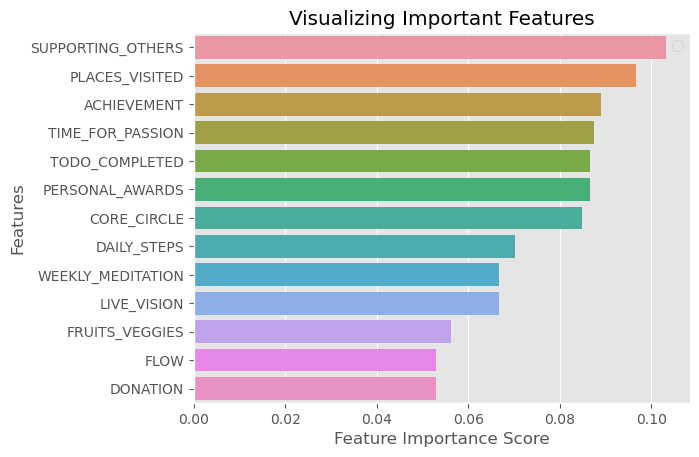

In [126]:
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import seaborn as sns

#Create a RandomForestClassifier
clf=RandomForestClassifier(n_estimators=100)

clf.fit(X_train,y_train)

feature_imp = pd.Series(clf.feature_importances_,index=X_train.columns).sort_values(ascending=False)
feature_imp

# Creating a bar plot
sns.barplot(x=feature_imp, y=feature_imp.index)
# Add labels to your graph
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title("Visualizing Important Features")
plt.legend()
plt.show()

To avoid overfitting, we will only take the top 10 features that contribute the most in accurate feature prediction

[['SUPPORTING_OTHERS','PLACES_VISITED', 'ACHIEVEMENT','TIME_FOR_PASSION', 'PERSONAL_AWARDS','CORE_CIRCLE','TODO_COMPLETED','DAILY_STEPS', 'LIVE_VISION', 'WEEKLY_MEDITATION']]

# Finding Optimal Depth via K-fold Cross-Validation for RandomForest

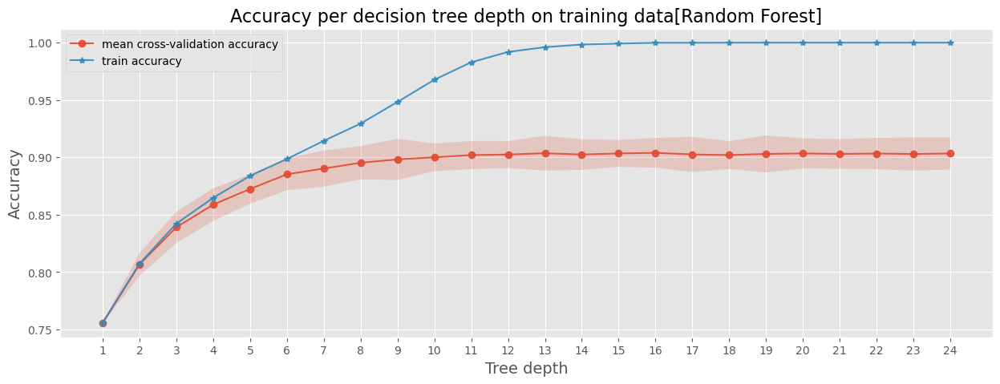

In [130]:
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.model_selection import cross_val_score
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

def run_cross_validation_on_trees(X, y, tree_depths, cv=10, criterion='gini', scoring='accuracy'):
    cv_scores_list = []
    cv_scores_std = []
    cv_scores_mean = []
    accuracy_scores = []
    for depth in tree_depths:
        tree_model = RandomForestClassifier(criterion=criterion, max_depth=depth,random_state=42)
        cv_scores = cross_val_score(tree_model, X, y, cv=cv, scoring=scoring)
        cv_scores_list.append(cv_scores)
        cv_scores_mean.append(cv_scores.mean())
        cv_scores_std.append(cv_scores.std())
        accuracy_scores.append(tree_model.fit(X, y).score(X, y))
    cv_scores_mean = np.array(cv_scores_mean)
    cv_scores_std = np.array(cv_scores_std)
    accuracy_scores = np.array(accuracy_scores)
    return cv_scores_mean, cv_scores_std, accuracy_scores
  
# function for plotting cross-validation results
def plot_cross_validation_on_trees(depths, cv_scores_mean, cv_scores_std, accuracy_scores, title):
    fig, ax = plt.subplots(1,1, figsize=(15,5))
    ax.plot(depths, cv_scores_mean, '-o', label='mean cross-validation accuracy', alpha=0.9)
    ax.fill_between(depths, cv_scores_mean-2*cv_scores_std, cv_scores_mean+2*cv_scores_std, alpha=0.2)
    ax.plot(depths, accuracy_scores, '-*', label='train accuracy', alpha=0.9)
    ax.set_title(title, fontsize=16)
    ax.set_xlabel('Tree depth', fontsize=14)
    ax.set_ylabel('Accuracy', fontsize=14)
    ax.set_xticks(depths)
    ax.legend()

# fitting trees of depth 1 to 24
sm_tree_depths = range(1,25)
sm_cv_scores_mean, sm_cv_scores_std, sm_accuracy_scores = run_cross_validation_on_trees(X_train, y_train, sm_tree_depths)
# plotting accuracy
plot_cross_validation_on_trees(sm_tree_depths, sm_cv_scores_mean, sm_cv_scores_std, sm_accuracy_scores, 
                               'Accuracy per decision tree depth on training data[Random Forest]')


Thus, we will be using depth = 9, as it's the optimal depth for our dataset

# Building Random Forest Model ( Without CrossValidation)

Classification report - 
               precision    recall  f1-score   support

           0       0.40      0.11      0.17        19
           1       0.89      0.92      0.91      3598
           2       0.73      0.68      0.70      1175

    accuracy                           0.86      4792
   macro avg       0.67      0.57      0.59      4792
weighted avg       0.85      0.86      0.85      4792



Text(0.5, 1.0, '**gini Random Forest Model**')

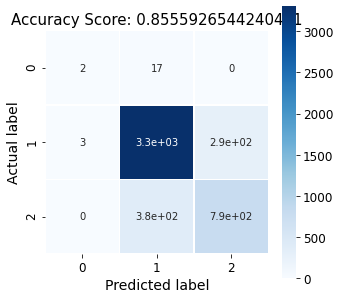

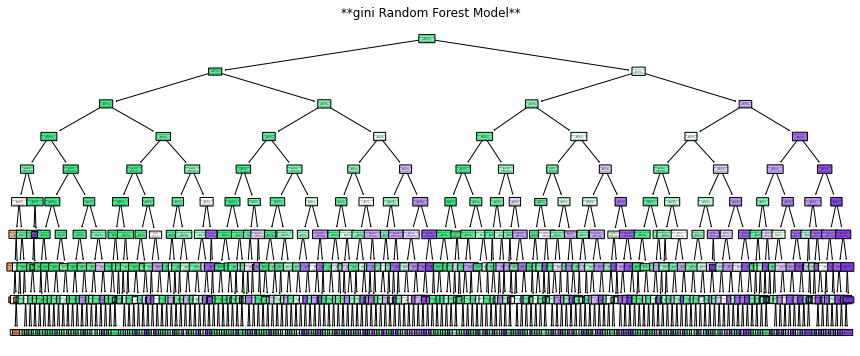

In [68]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

# Create Decision Tree classifer object
RFC = RandomForestClassifier(max_depth =9,random_state=42)

# Train Decision Tree Classifer
RFC = clf.fit(X_train,y_train)

#Predict the response for test dataset
y_pred = RFC.predict(X_test)

print("Classification report - \n", classification_report(y_test,y_pred))

# Plot the confusion matrix as follows
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(5,5))
sns.heatmap(data=cm,linewidths=.5, annot=True,square = True,  cmap = 'Blues')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Accuracy Score: {0}'.format(clf.score(X_test, y_test))
plt.title(all_sample_title, size = 15)

#******************************************************************************************
# Plot the DT
plt.figure(figsize=(15, 6))
plot_tree(clf, class_names=['Poor','Good','Excellent'], 
          feature_names= X_train.columns,
          rounded=True, filled=True)
plt.title("**gini Random Forest Model**")


# Building Random Forest Model (With CrossValidation)

Due to the sake of the simplicity we have pruned the tree to a maximum depth of two as the accuracy doens't change as you can see from the above figure.

In [127]:
scoring = ['accuracy', 'precision_macro', 'recall_macro', 'f1_macro']

# gini DT scores 
print("-- 10-fold cross-validation for 9-depth **gini** RandomForestClassifier --")
print("---------------------------------------------------")
tree_clf_2_g = RandomForestClassifier(criterion='gini',max_depth=9, random_state=42)
tree_clf_2_g.fit(X_train, y_train)
scores = cross_validate(estimator=tree_clf_2_g, X=X_train, y=y_train, cv=10, scoring=scoring,
                            return_train_score=True)  

#Predict the response for test dataset
y_pred = tree_clf_2_g.predict(X_test)

print("Classification report **gini**- \n", classification_report(y_test,y_pred))
print("Classification report **gini**- \n", classification_report(y,y_pred))
print('Test_accuracy: {}'.format(mean(scores['test_accuracy'])))
print('Train_accuracy: {}'.format(mean(scores['train_accuracy'])))
print('Test_precision_macro: {}'.format(mean(scores['test_precision_macro'])))
print('Train_precision_macro: {}'.format(mean(scores['train_precision_macro'])))
print('Test_recall_macro: {}'.format(mean(scores['test_recall_macro'])))
print('Train_recall_macro: {}'.format(mean(scores['train_recall_macro'])))
print('Test_f1_macro: {}'.format(mean(scores['test_f1_macro'])))
print('Train_f1_macro: {}'.format(mean(scores['train_f1_macro'])))

print('\n*********************************************************************************************')

# gini entropy scores
print("\n-- 10-fold cross-validation for 9-depth **entropy** RandomForestClassifier --")
print("---------------------------------------------------")

tree_clf_2_e = RandomForestClassifier(criterion='entropy',max_depth=9, random_state=42)
tree_clf_2_e.fit(X_train, y_train)
scores = cross_validate(estimator=tree_clf_2_e, X=X_train, y=y_train, cv=10, scoring=scoring,
                            return_train_score=True)

#Predict the response for test dataset
y_pred = tree_clf_2_e.predict(X_test)

print("Classification report **entropy**- \n", classification_report(y_test,y_pred))
print("Classification report **gini**- \n", classification_report(y,y_pred))
print('Test_accuracy: {}'.format(mean(scores['test_accuracy'])))
print('Train_accuracy: {}'.format(mean(scores['train_accuracy'])))
print('Test_precision_macro: {}'.format(mean(scores['test_precision_macro'])))
print('Train_precision_macro: {}'.format(mean(scores['train_precision_macro'])))
print('Test_recall_macro: {}'.format(mean(scores['test_recall_macro'])))
print('Train_recall_macro: {}'.format(mean(scores['train_recall_macro'])))
print('Test_f1_macro: {}'.format(mean(scores['test_f1_macro'])))
print('Train_f1_macro: {}'.format(mean(scores['train_f1_macro'])))


-- 10-fold cross-validation for 9-depth **gini** RandomForestClassifier --
---------------------------------------------------


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification report **gini**- 
               precision    recall  f1-score   support

           0       0.83      0.28      0.42        18
           1       0.90      0.96      0.93      3631
           2       0.85      0.68      0.76      1143

    accuracy                           0.89      4792
   macro avg       0.86      0.64      0.70      4792
weighted avg       0.89      0.89      0.89      4792



C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


ValueError: Found input variables with inconsistent numbers of samples: [15971, 4792]

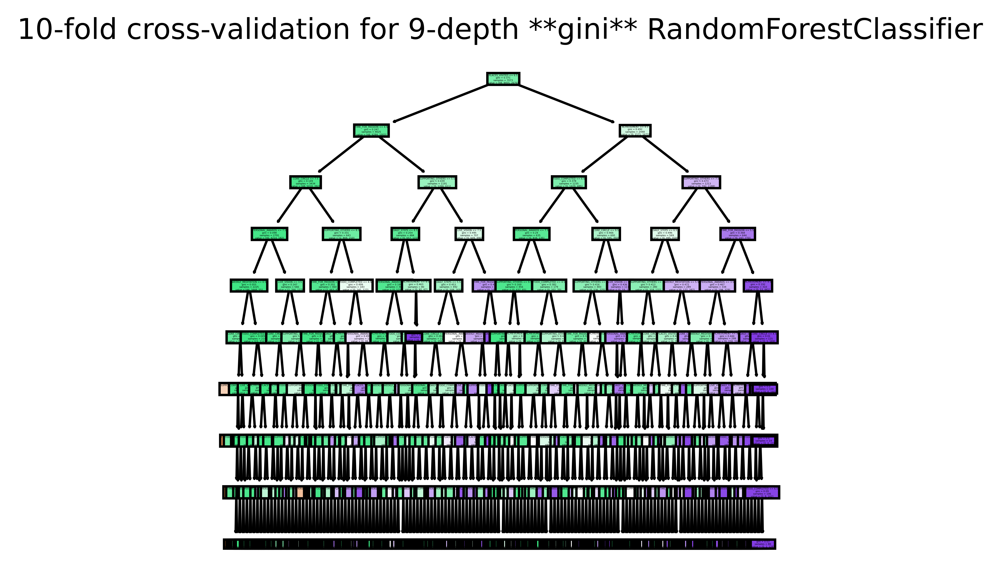

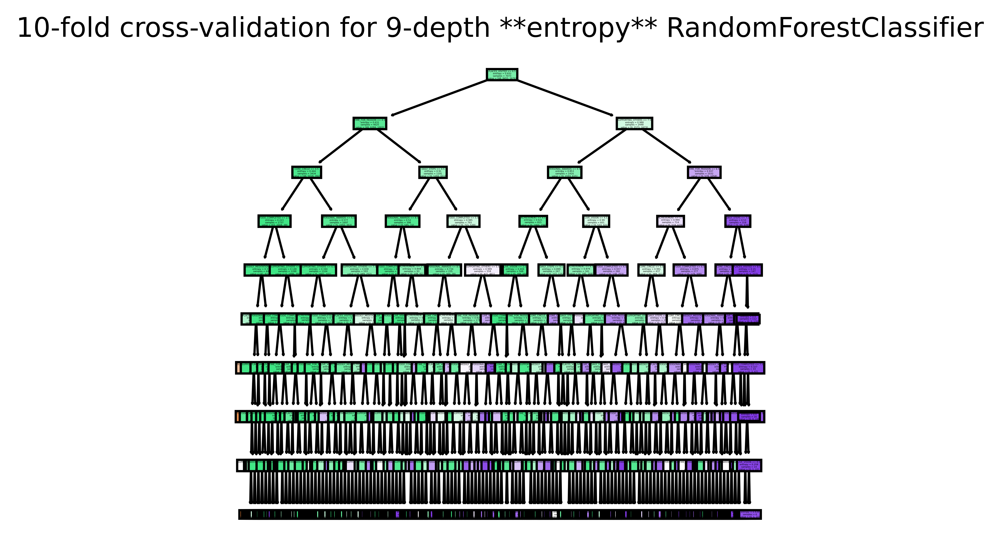

In [75]:
from sklearn import tree
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,4), dpi=800)
tree.plot_tree(tree_clf_2_g.estimators_[0],
               feature_names = X_train.columns, 
               filled = True);
plt.title("10-fold cross-validation for 9-depth **gini** RandomForestClassifier")
fig.savefig('rf_gini.png')
#------------------------------------------------
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,4), dpi=800)
tree.plot_tree(tree_clf_2_e.estimators_[0],
               feature_names = X_train.columns, 
               filled = True);
plt.title("10-fold cross-validation for 9-depth **entropy** RandomForestClassifier")
fig.savefig('rf_entropy.png')


# Tuning min_samples_leaf Regularization Hyperparameter

In [79]:
from sklearn.model_selection import cross_validate
from sklearn.metrics import recall_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score

#################################
#Cross Validation with 10 folds with depth 2 as it's the optimal depth, change the min_samples_leaf
# from 1,4,9,..
itr = []
for i in range(1,5):
    clf = RandomForestClassifier(max_depth=9, min_samples_leaf= i**2)
    # Perform 10-fold cross validation 
    scores = cross_validate(estimator=clf, X=X_train, y=y_train, cv=10, scoring=scoring,
                            return_train_score=True)    
    # predict the result
    clf2 = clf.fit(X_train, y_train)
    y_pred = clf2.predict(X_test)
    
    cm = confusion_matrix(y_test, y_pred, labels=[0, 1, 2])
    TP = cm[1,1]
    TN = cm[0,0] + cm[0,2] + cm[2,0] + cm[2,2]
    FP = cm[0,1] + cm[2,1]
    FN = cm[1,0] + cm[0,2]

    y_prob = clf2.predict_proba(X_test)
    ROC_AUC = roc_auc_score(y_test, y_prob, multi_class="ovo")
    correct_pred=  TP + TN
    incorrect_pred= FP + FN 
    itr.append(" min_samples_leaf:{}, TP:{}, TN:{}, FP:{}, FN:{}, ROC_AUC:{}, correct_pred:{}, incorrect_pred:{}".
                 format(i**2,scores,TP,TN,FP,FN,ROC_AUC, correct_pred, incorrect_pred))

print(*itr, sep = "\n*********************************************************************************************\n")


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedM

 min_samples_leaf:1, TP:{'fit_time': array([0.39900398, 0.41499949, 0.39605403, 0.40799856, 0.39599967,
       0.43199944, 0.39799953, 0.40199947, 0.39003062, 0.40301418]), 'score_time': array([0.01800084, 0.01800346, 0.01594615, 0.01600051, 0.01700187,
       0.01900911, 0.01700044, 0.01600051, 0.01596975, 0.01601601]), 'test_accuracy': array([0.88372093, 0.88282648, 0.90161002, 0.87924866, 0.89892665,
       0.88640429, 0.87477639, 0.89892665, 0.88014311, 0.88988362]), 'train_accuracy': array([0.94384256, 0.94364377, 0.94135772, 0.94334559, 0.94255044,
       0.94185469, 0.94364377, 0.94274923, 0.94503528, 0.94424568]), 'test_precision_macro': array([0.90452192, 0.9039013 , 0.92528021, 0.90100111, 0.92445864,
       0.91404759, 0.73108481, 0.91896745, 0.56953109, 0.90638552]), 'train_precision_macro': array([0.96134354, 0.96114285, 0.94069341, 0.960672  , 0.96070466,
       0.95942934, 0.9611549 , 0.96008029, 0.96202012, 0.96143186]), 'test_recall_macro': array([0.67531677, 0.6740541

# Part 4:

# Logistic Regression (Without Cross Validation)

We will use Logistic regression, since we have many features.

In [115]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
import seaborn as sns
from numpy import mean
from numpy import std
# import the metrics class
from sklearn import metrics

# to make this notebook's output stable across runs
np.random.seed(42)

# Split to X and y 
X = data_encoded.drop(['Score_encoded'], axis=1)
    
y = data_encoded['Score_encoded']

#Random Split the dataset to training and test datasets 70/30 
# for research question change it to 0.6
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 42);


LR = LogisticRegression()

# fitting the training data
LR.fit(X_train, y_train)

# predict
y_pred=LR.predict(X_test)

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
print('Confusion_Matrix: {}'.format(cnf_matrix))
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))
print("Precision:",metrics.precision_score(y_test, y_pred, average='macro'))
print("Recall:",metrics.recall_score(y_test, y_pred, average='macro'))


Confusion_Matrix: [[   8   10    0]
 [  12 3432  187]
 [   0  290  853]]
Accuracy: 0.8958681135225376
Precision: 0.7132688185340919
Recall: 0.7119734402060479


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


We got a classification rate of 89%, considered as good accuracy.

# Logistic Regression (With Corss Validation)

In [132]:
from numpy import mean
from numpy import absolute
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from numpy import sqrt


LR = LogisticRegression(max_iter=1000)

print("-- 10-fold cross-validation for Logistic Regression --")
print("---------------------------------------------------")
cv = KFold(n_splits=10, random_state=1, shuffle=True)
 
scores = cross_validate(LR, X=X, y=y, scoring=('accuracy','recall_macro','precision_macro'), cv=cv)
# report performance
print('Accuracy [Test]: {}'.format(mean(scores['test_accuracy'])))
print('Recall [Test]: {}'.format(mean(scores['test_recall_macro'])))
print('Precision [Test]: {}'.format(mean(scores['test_precision_macro'])))
print('\n*********************************************************************************************')


-- 10-fold cross-validation for Logistic Regression --
---------------------------------------------------
Accuracy [Test]: 0.902448779509139
Recall [Test]: 0.6814441015286841
Precision [Test]: 0.79179824425139

*********************************************************************************************


# Neural Network And CNN

# Perceptrons

Scikit-Learn provides a Perceptron class that implements a single threshold logic Unit (TLU) network. Contrary to Logistic Regression classifiers, Perceptrons do not output a class probability; rather, they just make predictions based on a hard threshold. This is one of the good reasons to prefer Logistic Regression over Perceptrons:

In [133]:
from sklearn.linear_model import Perceptron

X = data_encoded.drop(['Score_encoded'], axis=1)

y = data_encoded['Score_encoded']
    
per_clf = Perceptron(max_iter=1000, tol=1e-3, random_state=42)
per_clf.fit(X, y)

Perceptron(random_state=42)

Check out the different parameters of the perceptron. For example, learning_rate="constant", eta0=1 (the learning rate), and penalty=None (no regu‐ larization).

In [141]:
y_pred = per_clf.predict(X) # make prediction for new instance 
y_pred

array([1, 1, 1, ..., 2, 1, 1], dtype=int64)

# Activation functions

In [36]:
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

def relu(z):
    return np.maximum(0, z)

def derivative(f, z, eps=0.000001):
    return (f(z + eps) - f(z - eps))/(2 * eps)

def heaviside(z):
    return (z >= 0).astype(z.dtype)

def mlp_xor(x1, x2, activation=heaviside):
    return activation(-activation(x1 + x2 - 1.5) + activation(x1 + x2 - 0.5) - 0.5)

# Building an Image Classifier

In [37]:
import tensorflow as tf
from tensorflow import keras
from sklearn.model_selection import train_test_split

X_train_full, X_test, y_train_full, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)
X_valid, X_train = X_train_full[:5000] , X_train_full[5000:]
y_valid, y_train = y_train_full[:5000], y_train_full[5000:]
X_test = X_test

In [38]:
X_valid.shape

(5000, 13)

In [39]:
X_test.shape

(4792, 13)

We will use the rectified linear unit activation function referred to as ReLU on the first two layers and the Sigmoid function in the output layer.

It used to be the case that Sigmoid and Tanh activation functions were preferred for all layers. These days, better performance is achieved using the ReLU activation function. We use a sigmoid on the output layer to ensure our network output is between 0 and 1 and easy to map to either a probability of class 1 or snap to a hard classification of either class with a default threshold of 0.5.

We can piece it all together by adding each layer:

The model expects rows of data with 13 variables (the input_dim=13 argument)
The first hidden layer has 300 nodes and uses the relu activation function.
The second hidden layer has 100 nodes and uses the relu activation function.
The output layer has 3 nodes and uses the softmax activation function.

In [142]:
# define the keras model
model = keras.models.Sequential()
model.add(keras.layers.Flatten(input_shape=[13]))
model.add(keras.layers.Dense(300, activation="relu"))
model.add(keras.layers.Dense(100, activation="relu"))
model.add(keras.layers.Dense(3, activation="softmax"))

keras.backend.clear_session()
np.random.seed(42)
tf.random.set_seed(42)

model = keras.models.Sequential([
    keras.layers.Flatten(input_shape=[13]),
    keras.layers.Dense(300, activation="relu"),
    keras.layers.Dense(100, activation="relu"),
    keras.layers.Dense(3, activation="softmax")
])

print('Model Layer: {}'.format(model.layers))
print('Model Summary: {}'.format(model.summary()))



Model Layer: [<keras.layers.core.flatten.Flatten object at 0x0000029BC836E520>, <keras.layers.core.dense.Dense object at 0x0000029BDDC0C5E0>, <keras.layers.core.dense.Dense object at 0x0000029BD7161490>, <keras.layers.core.dense.Dense object at 0x0000029BD7161820>]
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 13)                0         
                                                                 
 dense (Dense)               (None, 300)               4200      
                                                                 
 dense_1 (Dense)             (None, 100)               30100     
                                                                 
 dense_2 (Dense)             (None, 3)                 303       
                                                                 
Total params: 34,603
Trainable params: 34,603
Non-trai

In [41]:
keras.utils.plot_model(model, "my_model.png", show_shapes=True)

('You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) ', 'for plot_model/model_to_dot to work.')


Because our problem is a Multi-Class Classification then we will use the Loss Functions that best fit 
with it which is one of these functions:
- Multi-Class Cross-Entropy Loss
- Sparse Multiclass Cross-Entropy Loss
- Kullback Leibler Divergence Loss

We will define the optimizer as the efficient stochastic gradient descent algorithm “adam“. This is a popular version of gradient descent because it automatically tunes itself and gives good results in a wide range of problems.

we will collect and report the classification accuracy, defined via the metrics argument.

157/157 [==============================] - 0s 461us/step - loss: 0.0800 - accuracy: 0.9648
Test Accuracy: 89.003
Training Accuracy: 96.681
Val Accuracy: 96.480


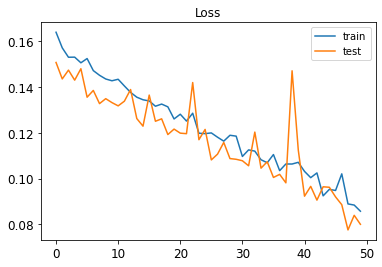

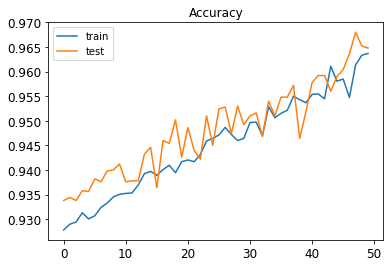

In [145]:
model.compile(loss='sparse_categorical_crossentropy',
              optimizer=keras.optimizers.Adam(learning_rate=0.001), 
             metrics=['accuracy'])
#keras.optimizers.SGD()

# fit the keras model on the dataset without progress bars
# Training occurs over epochs and each epoch is split into batches.
# Epoch: One pass through all of the rows in the training dataset.
# Batch: One or more samples considered by the model within an epoch before weights are updated.

history = model.fit(X_train, y_train, epochs=50,
                    validation_data=(X_valid, y_valid), verbose=0)

# evaluate the keras model
_, train_acc = model.evaluate(X_train, y_train)
_, test_acc = model.evaluate(X_test, y_test)
_, val_acc = model.evaluate(X_valid, y_valid)
print('Test Accuracy: %.3f' % (test_acc*100))
print('Training Accuracy: %.3f' % (train_acc*100))
print('Val Accuracy: %.3f' % (val_acc*100))

# plot loss during training
# Line Plots of Sparse Cross Entropy Loss and Classification Accuracy over Training
# Epochs on the Blobs Multi-Class Classification Problem
plt.title('Loss')
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()
# plot accuracy during training
plt.title('Accuracy')
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='test')
plt.legend()
plt.show()

In [148]:
history.history

{'loss': [0.16382662951946259,
  0.1570184826850891,
  0.15291711688041687,
  0.15295995771884918,
  0.1504952311515808,
  0.15234814584255219,
  0.14708775281906128,
  0.14504677057266235,
  0.1434270739555359,
  0.14265206456184387,
  0.14331285655498505,
  0.1403942108154297,
  0.13758797943592072,
  0.1354845017194748,
  0.1343662291765213,
  0.13384252786636353,
  0.13154087960720062,
  0.13248366117477417,
  0.1312771588563919,
  0.1259925216436386,
  0.1280582696199417,
  0.12506930530071259,
  0.1284901201725006,
  0.11975803971290588,
  0.11958862096071243,
  0.11989831179380417,
  0.11802470684051514,
  0.1163124144077301,
  0.11887387186288834,
  0.1184893250465393,
  0.10962077975273132,
  0.11249657720327377,
  0.11195088922977448,
  0.10819622874259949,
  0.10688656568527222,
  0.11046548932790756,
  0.10343123972415924,
  0.10634390264749527,
  0.10632640868425369,
  0.1070704460144043,
  0.10312038660049438,
  0.10037076473236084,
  0.10244667530059814,
  0.092436946928

Ideally, we would like the loss to go to zero and accuracy to go to 1.0 (e.g. 100%). This is not possible, however the goal is to choose a model configuration and training configuration that achieve the lowest loss and highest accuracy possible for a given dataset.

In [45]:
print('history.params: {}'.format(history.params)) 
print('history.epoch: {}'.format(history.epoch)) 
print('history.keys: {}'.format(history.history.keys())) 

history.params: {'verbose': 0, 'epochs': 50, 'steps': 618}
history.epoch: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]
history.keys: dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


In [46]:
X_new = X_test[:3]
y_proba = model.predict(X_new)
y_proba.round(2)

#y_pred = model.predict_classes(X_new) # deprecated
y_pred = np.argmax(model.predict(X_new), axis=-1)
y_pred

class_values = [0,1,2]
np.array(class_values)[y_pred]

y_new = y_test[:3]
y_new

10730    1
476      1
4291     1
Name: Score_encoded, dtype: int64

# Regression MLP

----------------Regression MLP--------------
157/157 [==============================] - 0s 410us/step - loss: 0.0989 - accuracy: 0.7596
Test Accuracy: 75.438
Train Accuracy: 75.266
Val Accuracy: 75.960


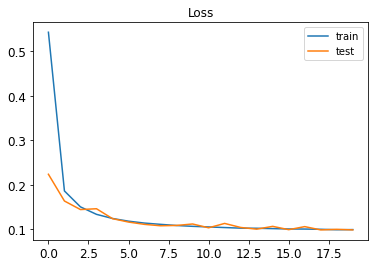

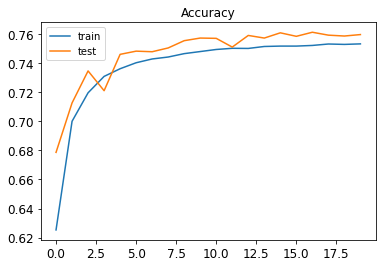

In [158]:
print("----------------Regression MLP--------------")
model = keras.models.Sequential([
    keras.layers.Dense(30, activation="relu", input_shape=X_train.shape[1:]),
    keras.layers.Dense(1)
])

model.compile(loss="mean_squared_error", optimizer=keras.optimizers.SGD(learning_rate=1e-3),
              metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=20, validation_data=(X_valid, y_valid), verbose=0)
_,mse_test = model.evaluate(X_test, y_test)
_,train_test = model.evaluate(X_train, y_train)
_,val_acc = model.evaluate(X_valid, y_valid)
X_new = X_test[:3]
y_pred = model.predict(X_new)
print('Test Accuracy: %.3f' % (mse_test*100))
print('Train Accuracy: %.3f' % (train_test*100))
print('Val Accuracy: %.3f' % (val_acc*100))

# plot loss during training
plt.title('Loss')
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()
# plot accuracy during training
plt.title('Accuracy')
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='test')
plt.legend()
plt.show()

# Functional API

Not all neural network models are simply sequential. Some may have complex topologies. Some may have multiple inputs and/or multiple outputs. For example, a Wide & Deep neural network (see paper) connects all or part of the inputs directly to the output layer.

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 13)]         0           []                               
                                                                                                  
 dense_29 (Dense)               (None, 30)           420         ['input_3[0][0]']                
                                                                                                  
 dense_30 (Dense)               (None, 30)           930         ['dense_29[0][0]']               
                                                                                                  
 concatenate_2 (Concatenate)    (None, 43)           0           ['input_3[0][0]',                
                                                                  'dense_30[0][0]']         

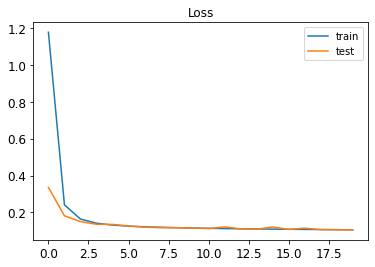

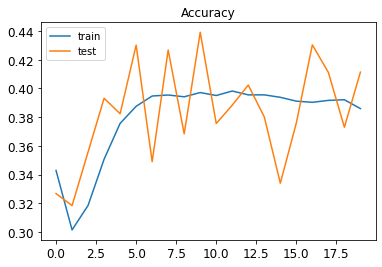

In [161]:
np.random.seed(42)
tf.random.set_seed(42)

input_ = keras.layers.Input(shape=X_train.shape[1:])
hidden1 = keras.layers.Dense(30, activation="relu")(input_)
hidden2 = keras.layers.Dense(30, activation="relu")(hidden1)
concat = keras.layers.concatenate([input_, hidden2])
output = keras.layers.Dense(3)(concat)
model = keras.models.Model(inputs=[input_], outputs=[output])

print(model.summary())

#-------------------------------------------------------------------
print("---------------- Functional API --------------")
model.compile(loss="mean_squared_error", optimizer=keras.optimizers.SGD(learning_rate=1e-3),  
              metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=20,
                    validation_data=(X_valid, y_valid), verbose=0)
_,mse_test = model.evaluate(X_test, y_test)
_,train_test = model.evaluate(X_train, y_train)
_,val_acc = model.evaluate(X_valid, y_valid)
X_new = X_test[:3]
y_pred = model.predict(X_new)
print('Test Accuracy: %.3f'%(mse_test*100))
print('Train Accuracy: %.3f'%(train_test*100))
print('Val Accuracy: %.3f' % (val_acc*100))

# plot loss during training
plt.title('Loss')
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()
# plot accuracy during training
plt.title('Accuracy')
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='test')
plt.legend()
plt.show()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 13)]         0           []                               
                                                                                                  
 dense_32 (Dense)               (None, 30)           420         ['input_4[0][0]']                
                                                                                                  
 dense_33 (Dense)               (None, 30)           930         ['dense_32[0][0]']               
                                                                                                  
 concatenate_3 (Concatenate)    (None, 43)           0           ['input_4[0][0]',                
                                                                  'dense_33[0][0]']         

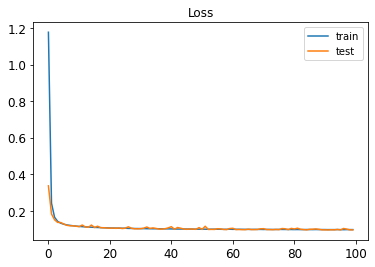

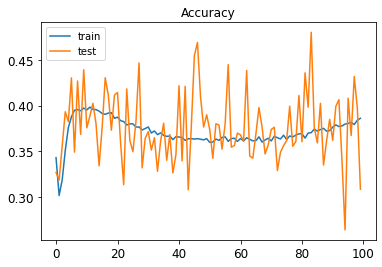

In [162]:
# With epochs = 100 
np.random.seed(42)
tf.random.set_seed(42)

input_ = keras.layers.Input(shape=X_train.shape[1:])
hidden1 = keras.layers.Dense(30, activation="relu")(input_)
hidden2 = keras.layers.Dense(30, activation="relu")(hidden1)
concat = keras.layers.concatenate([input_, hidden2])
output = keras.layers.Dense(3)(concat)
model = keras.models.Model(inputs=[input_], outputs=[output])

print(model.summary())

#-------------------------------------------------------------------
print("---------------- Functional API --------------")
model.compile(loss="mean_squared_error", optimizer=keras.optimizers.SGD(learning_rate=1e-3),  
              metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=100,
                    validation_data=(X_valid, y_valid), verbose=0)
_,mse_test = model.evaluate(X_test, y_test)
_,train_test = model.evaluate(X_train, y_train)
_,val_acc = model.evaluate(X_valid, y_valid)
X_new = X_test[:3]
y_pred = model.predict(X_new)
print('Test Accuracy: %.3f'%(mse_test*100))
print('Train Accuracy: %.3f'%(train_test*100))
print('Val Accuracy: %.3f' % (val_acc*100))

# plot loss during training
plt.title('Loss')
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()
# plot accuracy during training
plt.title('Accuracy')
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='test')
plt.legend()
plt.show()

What if you want to send different subsets of input features through the wide or deep paths? We will send 5 features (features 0 to 4), and 6 through the deep path (features 2 to 7). Note that 3 features will go through both (features 2, 3 and 4).

---------------- Functional API (diff subsets) --------------
157/157 [==============================] - 0s 461us/step - loss: 0.1169 - accuracy: 0.2348
Test Accuracy: 24.457
Train Accuracy: 24.009
Val Accuracy: 23.480


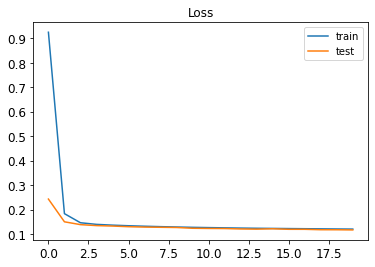

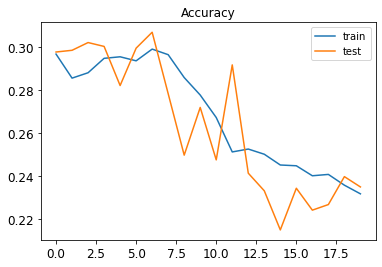

In [163]:
print("---------------- Functional API (diff subsets) --------------")
input_A = keras.layers.Input(shape=[5], name="wide_input")
input_B = keras.layers.Input(shape=[2], name="deep_input")
hidden1 = keras.layers.Dense(30, activation="relu")(input_B)
hidden2 = keras.layers.Dense(30, activation="relu")(hidden1)
concat = keras.layers.concatenate([input_A, hidden2])
output = keras.layers.Dense(3, name="output")(concat)
model = keras.models.Model(inputs=[input_A, input_B], outputs=[output])

model.compile(loss="mse", optimizer=keras.optimizers.SGD(learning_rate=1e-3), metrics=['accuracy'])

X_train_A, X_train_B = X_train[X_train.columns[:5]], X_train[X_train.columns[:2]]
X_valid_A, X_valid_B = X_valid[X_valid.columns[:5]], X_valid[X_valid.columns[:2]]
X_test_A, X_test_B = X_test[X_test.columns[:5]], X_test[X_test.columns[:2]]
X_new_A, X_new_B = X_test_A[X_test_A.columns[:3]], X_test_B[X_test_B.columns[:3]]

history = model.fit((X_train_A, X_train_B), y_train, epochs=20,
                    validation_data=((X_valid_A, X_valid_B), y_valid), verbose=0)
_,mse_test = model.evaluate((X_test_A, X_test_B), y_test)
_,train_test = model.evaluate((X_train_A, X_train_B), y_train)
_,val_acc = model.evaluate((X_valid_A, X_valid_B), y_valid)

print('Test Accuracy: %.3f'%(mse_test*100))
print('Train Accuracy: %.3f'%(train_test*100))
print('Val Accuracy: %.3f' % (val_acc*100))

# plot loss during training
plt.title('Loss')
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()
# plot accuracy during training
plt.title('Accuracy')
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='test')
plt.legend()
plt.show()

# Saving and Restoring

In [50]:
np.random.seed(42)
tf.random.set_seed(42)

model = keras.models.Sequential([
    keras.layers.Dense(30, activation="relu", input_shape=[13]),
    keras.layers.Dense(30, activation="relu"),
    keras.layers.Dense(3)
])  

model.compile(loss="mse", optimizer=keras.optimizers.SGD(learning_rate=1e-3),metrics=['accuracy'])
history = model.fit(X_train, y_train, epochs=10, validation_data=(X_valid, y_valid), verbose=0)
mse_test = model.evaluate(X_test, y_test)
train_test = model.evaluate(X_train, y_train)
print('Test Accuracy:{}'.format(mse_test))
print('Train Accuracy:{}'.format(train_test))

model.save("my_keras_model.h5")

model = keras.models.load_model("my_keras_model.h5")
model.predict(X_new)

model.save_weights("my_keras_weights.ckpt")
model.load_weights("my_keras_weights.ckpt")


194/194 [==============================] - 0s 435us/step - loss: 0.1297 - accuracy: 0.3737
Test Accuracy:[0.1327955424785614, 0.3666527569293976]
Train Accuracy:[0.12967616319656372, 0.3736850619316101]


# Using Callbacks during Training

In [51]:
keras.backend.clear_session()
np.random.seed(42)
tf.random.set_seed(42)

model = keras.models.Sequential([
    keras.layers.Dense(30, activation="relu", input_shape=[13]),
    keras.layers.Dense(30, activation="relu"),
    keras.layers.Dense(3)
])  

model.compile(loss="mse", optimizer=keras.optimizers.SGD(learning_rate=1e-3),metrics=['accuracy'])
checkpoint_cb = keras.callbacks.ModelCheckpoint("my_keras_model.h5", save_best_only=True)
history = model.fit(X_train, y_train, epochs=10,
                    validation_data=(X_valid, y_valid),
                    callbacks=[checkpoint_cb], verbose=0)
model = keras.models.load_model("my_keras_model.h5") # rollback to best model
mse_test = model.evaluate(X_test, y_test)
train_test = model.evaluate(X_train, y_train)
print('Test Accuracy:{}'.format(mse_test))
print('Train Accuracy:{}'.format(train_test))


194/194 [==============================] - 0s 432us/step - loss: 0.1297 - accuracy: 0.3737
Test Accuracy:[0.1327955424785614, 0.3666527569293976]
Train Accuracy:[0.12967616319656372, 0.3736850619316101]


In [52]:
model.compile(loss="mse", optimizer=keras.optimizers.SGD(learning_rate=1e-3),metrics=['accuracy'])
early_stopping_cb = keras.callbacks.EarlyStopping(patience=10,
                                                  restore_best_weights=True)
history = model.fit(X_train, y_train, epochs=100,
                    validation_data=(X_valid, y_valid),
                    callbacks=[checkpoint_cb, early_stopping_cb], verbose=0)
mse_test = model.evaluate(X_test, y_test)
train_test = model.evaluate(X_train, y_train)
print('Test Accuracy:{}'.format(mse_test))
print('Train Accuracy:{}'.format(train_test))

194/194 [==============================] - 0s 431us/step - loss: 0.1031 - accuracy: 0.4472
Test Accuracy:[0.10561586171388626, 0.4353088438510895]
Train Accuracy:[0.10305903106927872, 0.4471597373485565]


# Hyperparameter Tuning

we will use Keras tuner is a library for tuning the hyperparameters of a neural network that
helps you to pick optimal hyperparametersin your neural network implement in Tensorflow.


In [104]:
import kerastuner as kt
from tensorflow import keras # importing keras

# 1 (Building the model using Keras Tuner) 

def model_builder(hp, n_hidden=1):
    '''
    Args:
    hp - Keras tuner object
    '''
    # Initialize the Sequential API and start stacking the layers
    model = keras.Sequential()
    model.add(keras.layers.Flatten(input_shape=[13]))
    # Tune the number of units in the first Dense layer
    # Choose an optimal value between 32-512
    hp_units = hp.Int('units', min_value=32, max_value=512, step=32)
    for layer in range(n_hidden):
        model.add(keras.layers.Dense(units=hp_units,
                                     activation=hp.Choice("activation", ["relu", "tanh"])
                                    ))
    # Add next layers
    model.add(keras.layers.Dense(1))
    model.add(keras.layers.Dense(3, activation='softmax'))
    # Tune the learning rate for the optimizer
    # Choose an optimal value from 0.01, 0.001, or 0.0001
    hp_learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=hp_learning_rate),
                loss=keras.losses.SparseCategoricalCrossentropy(),
                metrics=['accuracy'])
    return model

# 2 Instantiating the tuner and tuning the hyperparameters
# Instantiate the tuner
tuner = kt.Hyperband(model_builder, # the hypermodel
                     objective='val_accuracy', # objective to optimize
                     max_epochs=50,
                     factor=3, # factor which you have seen above 
                     directory='dir', # directory to save logs 
                     project_name='khyperband')

# hypertuning settings
tuner.search_space_summary() 

Search space summary
Default search space size: 3
units (Int)
{'default': None, 'conditions': [], 'min_value': 32, 'max_value': 512, 'step': 32, 'sampling': None}
activation (Choice)
{'default': 'relu', 'conditions': [], 'values': ['relu', 'tanh'], 'ordered': False}
learning_rate (Choice)
{'default': 0.01, 'conditions': [], 'values': [0.01, 0.001, 0.0001], 'ordered': True}


In [105]:
# 3 ( Searching the best hyperparameter ) 

stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
# Perform hypertuning
tuner.search(X_train, y_train, epochs=50,validation_data=(X_valid, y_valid), callbacks=[stop_early])

best_hp=tuner.get_best_hyperparameters()[0]

Trial 90 Complete [00h 00m 03s]
val_accuracy: 0.9017999768257141

Best val_accuracy So Far: 0.9046000242233276
Total elapsed time: 00h 02m 53s
INFO:tensorflow:Oracle triggered exit


In [164]:
print(best_hp.values)

{'units': 96, 'activation': 'relu', 'learning_rate': 0.01, 'tuner/epochs': 50, 'tuner/initial_epoch': 17, 'tuner/bracket': 2, 'tuner/round': 2, 'tuner/trial_id': 'ba688fd32ef8d9de1871889ecc6368cf'}


In [167]:
print("---------------- Optimal HP for NN Model --------------")
model = model_builder(best_hp)
history = model.fit(X_train, y_train, epochs=50,validation_data=(X_valid, y_valid), verbose=0)

#evaluate 
_, acc_test = model.evaluate(X_test,y_test)
_, acc_train = model.evaluate(X_train,y_train)
_, acc_val = model.evaluate(X_valid,y_valid)

print('Test Accuracy: %.3f' % (acc_test*100))
print('Train Accuracy: %.3f' % (acc_train*100))
print('Val Accuracy: %.3f' % (acc_val*100))


---------------- Optimal HP for NN Model --------------
157/157 [==============================] - 0s 404us/step - loss: 0.2050 - accuracy: 0.9060
Test Accuracy: 89.190
Train Accuracy: 90.518
Val Accuracy: 90.600


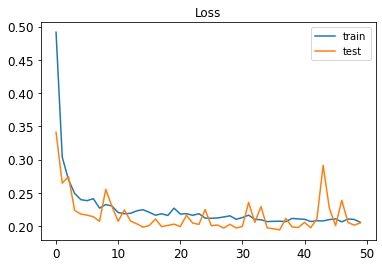

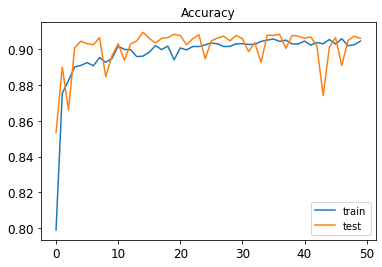

In [168]:
# plot loss during training
plt.title('Loss')
plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.show()
# plot accuracy during training
plt.title('Accuracy')
plt.plot(history.history['accuracy'], label='train')
plt.plot(history.history['val_accuracy'], label='test')
plt.legend()
plt.show()